In [1]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(
    { "figure.figsize": (8, 6) },
    style='ticks',
    color_codes=True,
    font_scale=0.8
)
%config InlineBackend.figure_formats = set(('retina', 'svg'))
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.metrics import mean_absolute_error, balanced_accuracy_score
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import LabelEncoder

import warnings
warnings.filterwarnings('ignore')

# Data Understanding

In [2]:
adv=pd.read_csv(r'C:\Users\janha\OneDrive\Desktop\AML\adverts.csv', nrows=30000)
adv.head()

,public_reference,mileage,reg_code,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,price,body_type,crossover_car_and_van,fuel_type
0,202006039777689,0.0,NaN,Grey,Volvo,XC90,NEW,NaN,73970,SUV,False,Petrol Plug-in Hybrid
1,202007020778260,108230.0,61,Blue,Jaguar,XF,USED,2011.0,7000,Saloon,False,Diesel
2,202007020778474,7800.0,17,Grey,SKODA,Yeti,USED,2017.0,14000,SUV,False,Petrol
3,202007080986776,45000.0,16,Brown,Vauxhall,Mokka,USED,2016.0,7995,Hatchback,False,Diesel
4,202007161321269,64000.0,64,Grey,Land Rover,Range Rover Sport,USED,2015.0,26995,SUV,False,Diesel


In [3]:
adv.tail()

,public_reference,mileage,reg_code,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,price,body_type,crossover_car_and_van,fuel_type
29995,202009063386611,15.0,NaN,Blue,Vauxhall,Grandland X,NEW,NaN,28000,SUV,False,Petrol
29996,202009083452262,10546.0,17,Green,Citroen,C3,USED,2017.0,7998,Hatchback,False,Petrol
29997,202009083471787,1501.0,70,White,Mercedes-Benz,SL Class,USED,2020.0,66990,Convertible,False,Petrol
29998,202009093491733,2869.0,20,Black,BMW,4 Series,USED,2020.0,28850,Coupe,False,Petrol
29999,202009093503686,124000.0,17,Silver,Mazda,CX-5,USED,2017.0,10890,SUV,False,Diesel


In [4]:
adv.shape

(30000, 12)

In [5]:
adv.columns

Index(['public_reference', 'mileage', 'reg_code', 'standard_colour',
       'standard_make', 'standard_model', 'vehicle_condition',
       'year_of_registration', 'price', 'body_type', 'crossover_car_and_van',
       'fuel_type'],
      dtype='object')

In [6]:
adv.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   public_reference       30000 non-null  int64  
 1   mileage                29993 non-null  float64
 2   reg_code               27649 non-null  object 
 3   standard_colour        29607 non-null  object 
 4   standard_make          30000 non-null  object 
 5   standard_model         30000 non-null  object 
 6   vehicle_condition      30000 non-null  object 
 7   year_of_registration   27546 non-null  float64
 8   price                  30000 non-null  int64  
 9   body_type              29944 non-null  object 
 10  crossover_car_and_van  30000 non-null  bool   
 11  fuel_type              29954 non-null  object 
dtypes: bool(1), float64(2), int64(2), object(7)
memory usage: 2.5+ MB


In [7]:
adv.describe()

,public_reference,mileage,year_of_registration,price
count,3.000000e+04,29993.000000,27546.000000,3.000000e+04
mean,2.020071e+14,37992.976528,2015.055725,1.738334e+04
std,1.612366e+10,34789.461930,4.333566,2.525670e+04
min,2.015062e+14,0.000000,1933.000000,2.500000e+02
25%,2.020090e+14,10612.000000,2013.000000,7.495000e+03
50%,2.020093e+14,28990.000000,2016.000000,1.274650e+04
75%,2.020102e+14,57000.000000,2018.000000,2.020275e+04
max,2.020110e+14,360000.000000,2020.000000,1.590000e+06


In [8]:
adv.isnull()

,public_reference,mileage,reg_code,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,price,body_type,crossover_car_and_van,fuel_type
0,False,False,True,False,False,False,False,True,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...
29995,False,False,True,False,False,False,False,True,False,False,False,False
29996,False,False,False,False,False,False,False,False,False,False,False,False
29997,False,False,False,False,False,False,False,False,False,False,False,False
29998,False,False,False,False,False,False,False,False,False,False,False,False


In [9]:
adv.isnull().sum()

public_reference            0
mileage                     7
reg_code                 2351
standard_colour           393
standard_make               0
standard_model              0
vehicle_condition           0
year_of_registration     2454
price                       0
body_type                  56
crossover_car_and_van       0
fuel_type                  46
dtype: int64

In [10]:
#let's look into some unique values Categorical Features
adv['vehicle_condition'].unique()

array(['NEW', 'USED'], dtype=object)

In [11]:
adv['body_type'].unique()

array(['SUV', 'Saloon', 'Hatchback', 'Convertible', 'Limousine', 'Estate',
       'MPV', 'Coupe', nan, 'Pickup', 'Combi Van', 'Panel Van', 'Minibus',
       'Window Van', 'Camper', 'Car Derived Van'], dtype=object)

In [12]:
adv['fuel_type'].unique()

array(['Petrol Plug-in Hybrid', 'Diesel', 'Petrol', 'Diesel Hybrid',
       'Petrol Hybrid', 'Electric', 'Diesel Plug-in Hybrid', nan,
       'Bi Fuel'], dtype=object)

In [13]:
adv['crossover_car_and_van'].unique()

array([False,  True])

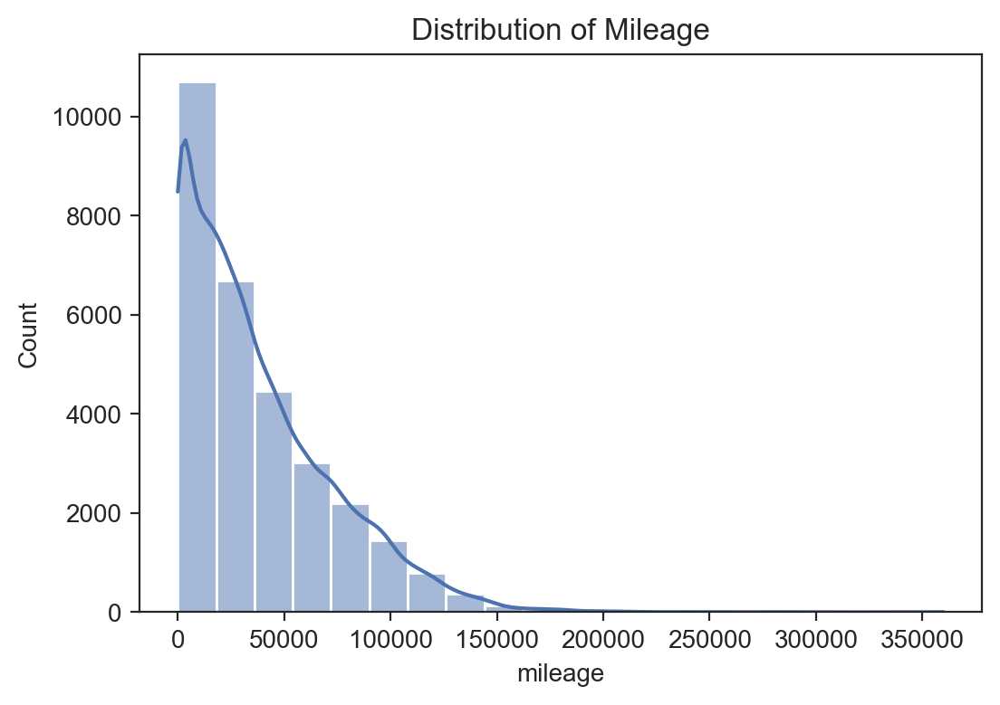

In [14]:
#Let's have a look into numerical features and their distribution
fig, ax = plt.subplots(figsize=(6,4))
sns.histplot(x='mileage', data=adv, kde=True, bins=20, ax=ax)
plt.title('Distribution of Mileage')
plt.show()

In [15]:
#round(adv_samp.isnull().sum()/len(adv_samp.index),2).sort_values(ascending=False).head(12)

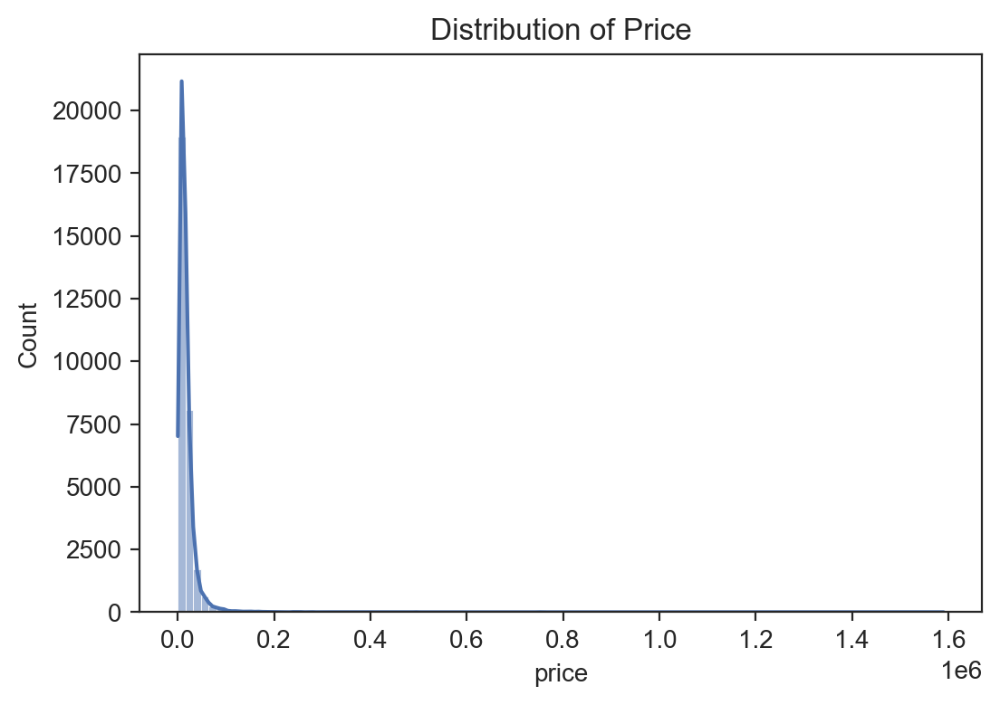

In [16]:
fig, ax = plt.subplots(figsize=(6,4))
sns.histplot(x=adv.loc[adv['price']>0, 'price'], kde=True, bins=100)
plt.title('Distribution of Price')
plt.show()

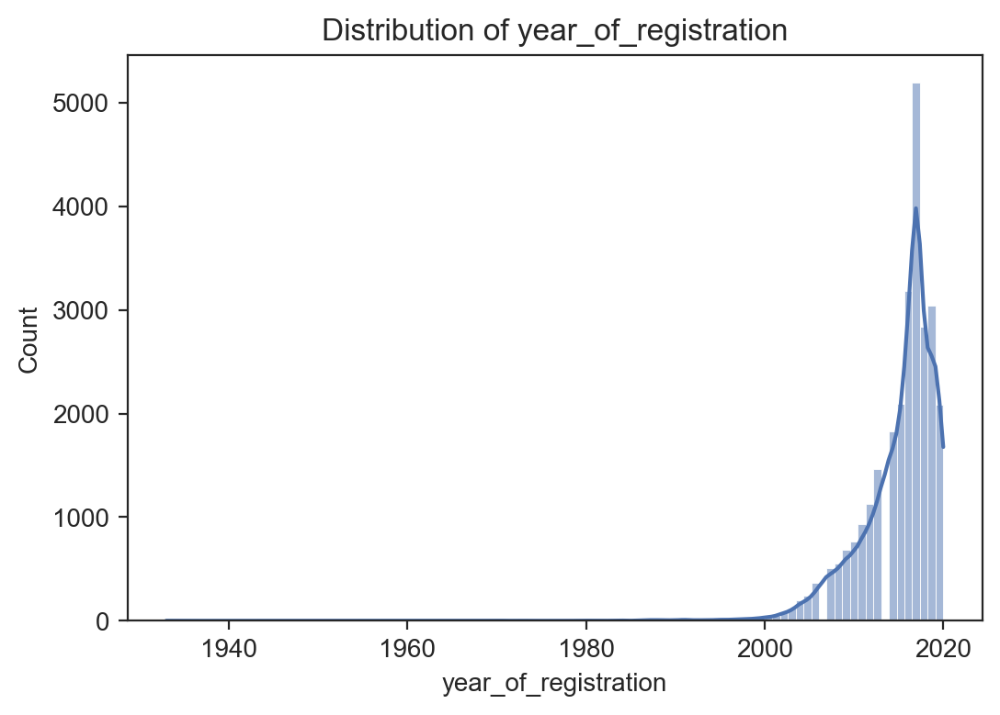

In [17]:
fig, ax = plt.subplots(figsize=(6,4))
sns.histplot(x=adv.loc[adv['year_of_registration']>0, 'year_of_registration'], kde=True, bins=100)
plt.title('Distribution of year_of_registration')
plt.show()

In [18]:
#Looking for correlation between numerical features of dataframe
#plt.figure(figsize=(8,4))
#sns.heatmap(adv_samp.corr(), annot = True , cmap='BuPu');

# Dealing with Missing Values and Outliers

In [19]:
adv.nunique()

public_reference         30000
mileage                  16024
reg_code                    62
standard_colour             20
standard_make               72
standard_model             738
vehicle_condition            2
year_of_registration        51
price                     7117
body_type                   15
crossover_car_and_van        2
fuel_type                    8
dtype: int64

In [20]:
adv.isnull().sum()

public_reference            0
mileage                     7
reg_code                 2351
standard_colour           393
standard_make               0
standard_model              0
vehicle_condition           0
year_of_registration     2454
price                       0
body_type                  56
crossover_car_and_van       0
fuel_type                  46
dtype: int64

In [21]:
missing_year_with_not_missing_reg = adv.loc[adv['year_of_registration'].isna() & ~adv['reg_code'].isna(), :]

In [22]:
missing_year_with_not_missing_reg

,public_reference,mileage,reg_code,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,price,body_type,crossover_car_and_van,fuel_type
54,202007030806426,30000.0,18,Red,Vauxhall,Insignia,USED,NaN,11990,Hatchback,False,Petrol
83,202008222801747,42847.0,61,Red,Honda,Jazz,USED,NaN,5695,Hatchback,False,Petrol
865,202010084741550,43130.0,66,White,Land Rover,Range Rover Sport,USED,NaN,35990,SUV,False,Diesel
968,202010305607535,63369.0,17,Blue,SKODA,Rapid Spaceback,USED,NaN,7490,Hatchback,False,Diesel
1256,202010225294466,18715.0,68,White,Volvo,V40,USED,NaN,16950,NaN,False,Petrol
...,...,...,...,...,...,...,...,...,...,...,...,...
28626,202006290645174,30115.0,16,Black,Audi,A4,USED,NaN,18950,Saloon,False,Petrol
28774,202010064665194,28110.0,67,Silver,Volkswagen,Passat,USED,NaN,15980,Saloon,False,Diesel
29129,202010165061400,37789.0,17,Blue,BMW,3 Series,USED,NaN,18000,Coupe,False,Diesel
29409,202010074694732,38078.0,15,Red,Peugeot,108,USED,NaN,6000,Hatchback,False,Petrol


In [23]:
import re

# Define a regular expression pattern to match the year digits in the number plate
year_pattern = r"(\d{2})$"

# Apply the pattern to the "reg_code" column to extract the year digits
missing_year_with_not_missing_reg["registration_year"] = missing_year_with_not_missing_reg["reg_code"].str.extract(year_pattern)

# Function to convert UK registration code to year
def registration_code_to_year(reg_code):
    if 0 <= int(reg_code) <= 50:
        return "20" + reg_code
    elif 51 <= int(reg_code) <= 99:
        return "20" + str(int(reg_code) - 50)
    else:
        return None

# Convert the year digits to a 4-digit format, considering the UK registration codes, and handle NaN values
missing_year_with_not_missing_reg.loc[pd.notna(missing_year_with_not_missing_reg["registration_year"]), "registration_year"] = missing_year_with_not_missing_reg.loc[pd.notna(missing_year_with_not_missing_reg["registration_year"]), "registration_year"].apply(
    registration_code_to_year
)

# Replace the missing values in the "year_of_registration" column with the corresponding year from the "registration_year" column
missing_year_with_not_missing_reg["year_of_registration"] = missing_year_with_not_missing_reg["registration_year"]

# Drop the "registration_year" column
missing_year_with_not_missing_reg.drop("registration_year", axis=1, inplace=True)

# Display the resulting dataframe with only the "reg_code" and "year_of_registration" columns
print(missing_year_with_not_missing_reg[["reg_code", "year_of_registration"]])

      reg_code year_of_registration
54          18                 2018
83          61                 2011
865         66                 2016
968         17                 2017
1256        68                 2018
...        ...                  ...
28626       16                 2016
28774       67                 2017
29129       17                 2017
29409       15                 2015
29415       63                 2013

[131 rows x 2 columns]


In [24]:
import pandas as pd

# Define the range of prices for each class
class_ranges = [(0, 10000), (10000, 20000), (20000, 30000), (30000, 40000), (40000, 50000), (50000, float('inf'))]
# Define a function to map each price to a category
def get_price_category(price):
    for i, (lower, upper) in enumerate(class_ranges):
        if price >= lower and price < upper:
            return i+1
    return len(class_ranges)
# Apply the get_price_category function to the 'price' column to get the category
adv['Price Category'] = adv['price'].apply(get_price_category)
adv.head()

,public_reference,mileage,reg_code,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,price,body_type,crossover_car_and_van,fuel_type,Price Category
0,202006039777689,0.0,NaN,Grey,Volvo,XC90,NEW,NaN,73970,SUV,False,Petrol Plug-in Hybrid,6
1,202007020778260,108230.0,61,Blue,Jaguar,XF,USED,2011.0,7000,Saloon,False,Diesel,1
2,202007020778474,7800.0,17,Grey,SKODA,Yeti,USED,2017.0,14000,SUV,False,Petrol,2
3,202007080986776,45000.0,16,Brown,Vauxhall,Mokka,USED,2016.0,7995,Hatchback,False,Diesel,1
4,202007161321269,64000.0,64,Grey,Land Rover,Range Rover Sport,USED,2015.0,26995,SUV,False,Diesel,3


In [25]:
adv['mileage']=adv['mileage'].fillna(adv['mileage'].mean())
adv['body_type']=adv['body_type'].fillna(adv['body_type'].mode()[0])
adv['fuel_type']=adv['fuel_type'].fillna(adv['fuel_type'].mode()[0])
adv['year_of_registration']=adv['year_of_registration'].fillna(adv['year_of_registration'].mode()[0])
adv['standard_colour']=adv['standard_colour'].fillna(adv['standard_colour'].mode()[0])

In [26]:
adv.isnull().sum()

public_reference            0
mileage                     0
reg_code                 2351
standard_colour             0
standard_make               0
standard_model              0
vehicle_condition           0
year_of_registration        0
price                       0
body_type                   0
crossover_car_and_van       0
fuel_type                   0
Price Category              0
dtype: int64

# Checking for outliers in quantitative features.


Mileage:

In [27]:
adv['mileage'].describe()

count     30000.000000
mean      37992.976528
std       34785.402788
min           0.000000
25%       10618.750000
50%       29000.000000
75%       57000.000000
max      360000.000000
Name: mileage, dtype: float64

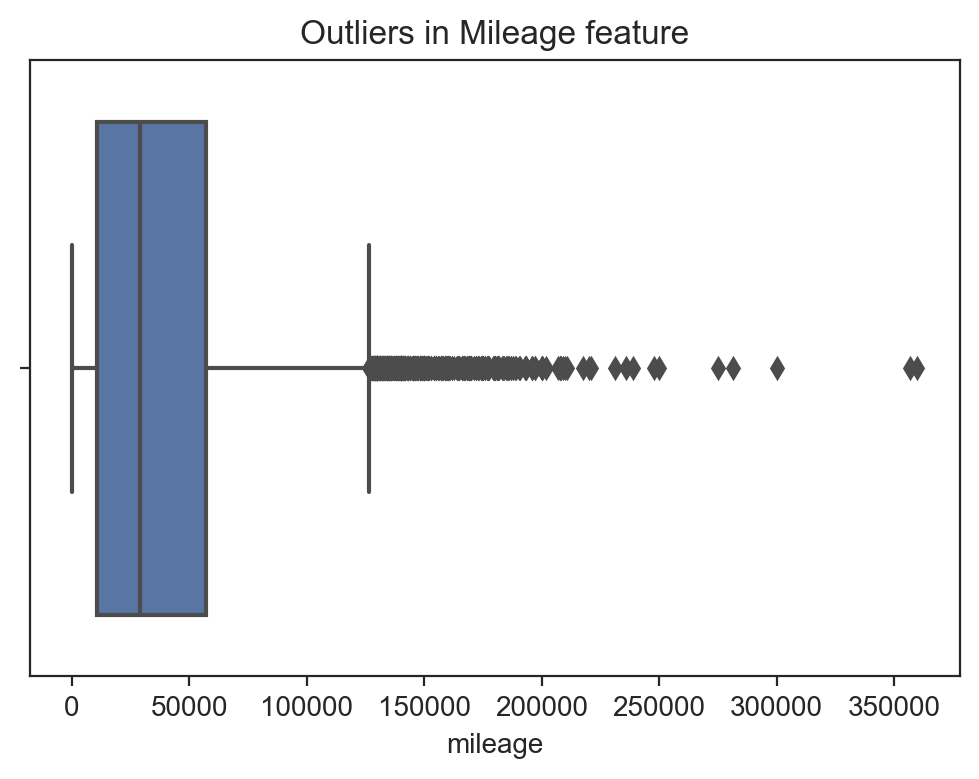

In [28]:
fig, ax = plt.subplots(figsize=(6,4))
sns.set(style='ticks', color_codes=True)
sns.boxplot(data=adv, x='mileage',ax=ax)
plt.title('Outliers in Mileage feature')
plt.show()

In [29]:
#print("99th Percentile of Mileage: ",adv['mileage'].quantile(0.99))

In [30]:
# Calculate the upper and lower limits for outlier detection
upper_limit = adv.mileage.quantile(0.99)
lower_limit = max(adv.mileage.mean() - 3 * adv.mileage.std(), 0)

# Find the outliers
outliers = adv[(adv.mileage > upper_limit) | (adv.mileage < lower_limit)]

# Cap the upper and lower limits at the desired values for the mileage column
adv['mileage'] = adv['mileage'].apply(lambda x: min(max(x, 0), upper_limit))

In [31]:
adv['mileage'].describe()

count     30000.000000
mean      37750.823528
std       33851.112177
min           0.000000
25%       10618.750000
50%       29000.000000
75%       57000.000000
max      141000.000000
Name: mileage, dtype: float64

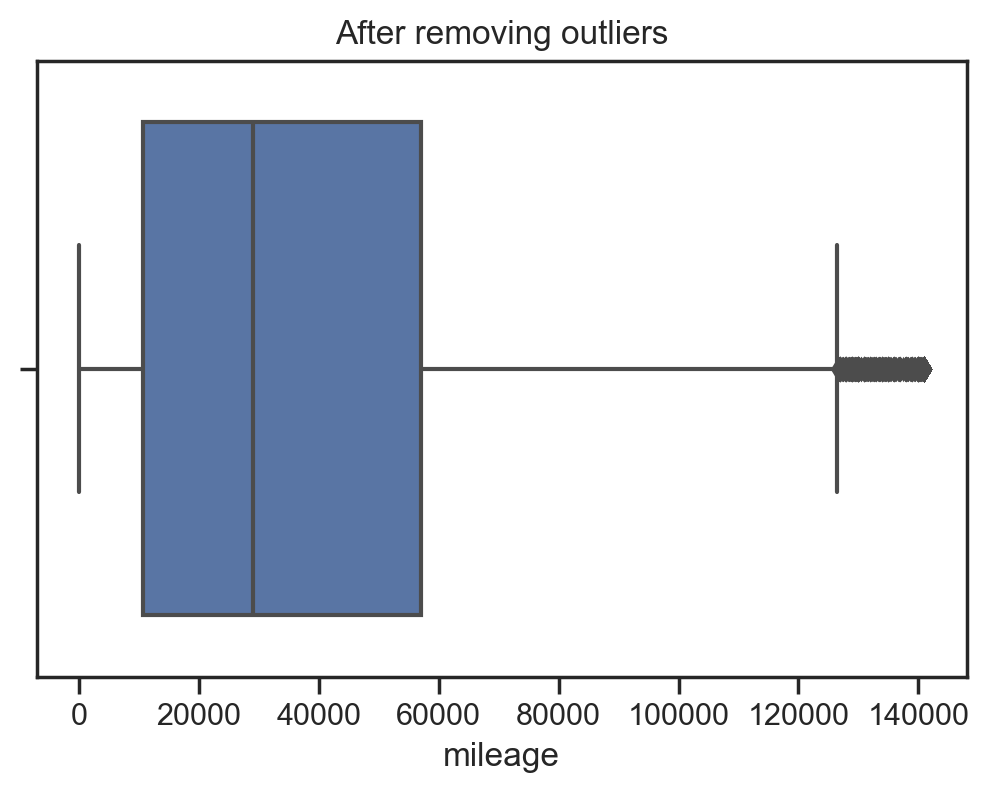

In [32]:
fig, ax = plt.subplots(figsize=(6,4))
plt.title("After removing outliers")
sns.boxplot(data=adv,x='mileage')
plt.show()

In [33]:
# #capping

# adv_cap = adv.copy()
# adv_cap['mileage'] = np.where(
#     adv_cap['mileage'] > upper_limit,
#     upper_limit,
#     np.where(
#         adv_cap['mileage'] < lower_limit,
#         lower_limit,
#         adv_cap['mileage']
#     )
# )
# plt.figure(figsize=(16,4))
# plt.subplot(2,2,4)
# plt.title("After Capping")
# sns.boxplot(data=adv_cap,x='mileage')
# plt.show()

Price:

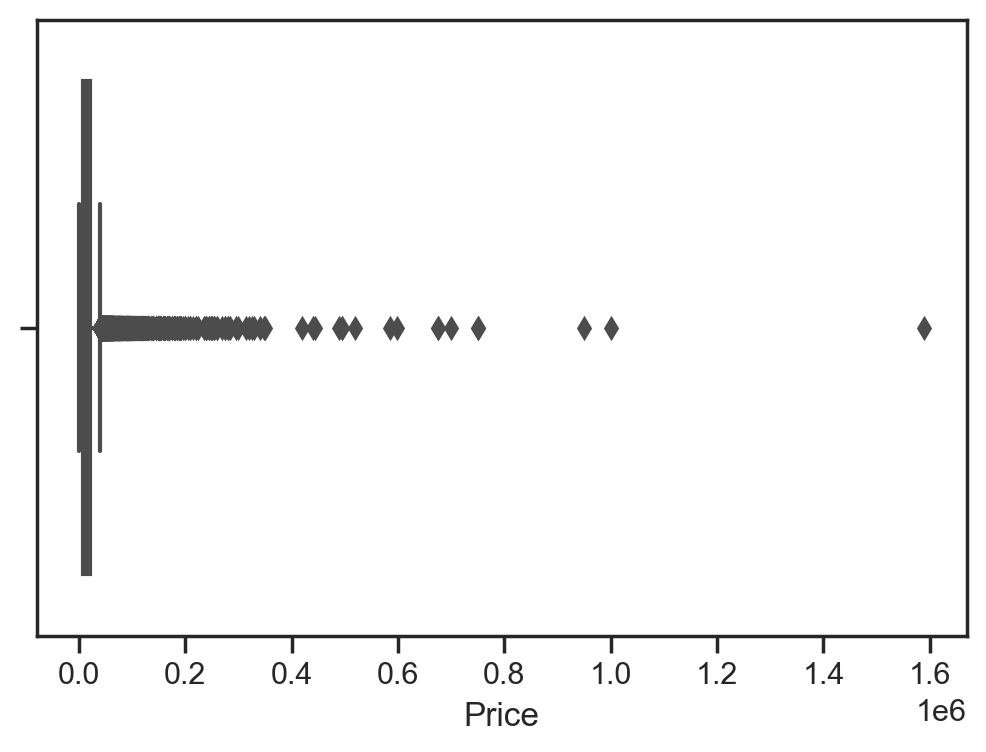

In [34]:
fig, ax = plt.subplots(figsize=(6,4))
sns.boxplot(x=adv['price'], ax=ax)
ax.set_xlabel('Price')
plt.show()

In [35]:
pd.set_option('display.float_format', lambda x: '%.2f' % x)
adv['price'].describe() 

count     30000.00
mean      17383.34
std       25256.70
min         250.00
25%        7495.00
50%       12746.50
75%       20202.75
max     1590000.00
Name: price, dtype: float64

In [36]:
upper_limit=adv.price.mean()+3*adv.price.std()
upper_limit

93153.45628692652

In [37]:
lower_limit=adv.price.mean()-3*adv.price.std()
lower_limit

-58386.77235359318

In [38]:
adv[(adv.price>upper_limit)|(adv.price<250)].head()

,public_reference,mileage,reg_code,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,price,body_type,crossover_car_and_van,fuel_type,Price Category
113,202009103575016,1568.00,19,Black,McLaren,Senna,USED,2019.00,585000,Coupe,False,Petrol,6
202,202010044584530,18000.00,18,Black,Land Rover,Range Rover Sport,USED,2018.00,97500,SUV,False,Petrol,6
362,202005279588456,10.00,NaN,Blue,Land Rover,Range Rover,NEW,2017.00,102473,SUV,False,Diesel,6
383,202007141227859,1.00,NaN,Black,BMW,X6M,NEW,2017.00,107490,SUV,False,Petrol,6
395,202008092275974,16050.00,14,Black,Ferrari,458,USED,2014.00,139990,Coupe,False,Petrol,6


In [39]:
## Capping the outlier
outliers_price=np.where(adv['price']>upper_limit,True,np.where(adv['price']<250,True,False))

In [40]:
outliers_price

array([False, False, False, ..., False, False, False])

In [41]:
new_price=adv.loc[~(outliers_price),]

In [42]:
adv=new_price=adv.loc[~(outliers_price),]

In [43]:
adv.shape

(29724, 13)

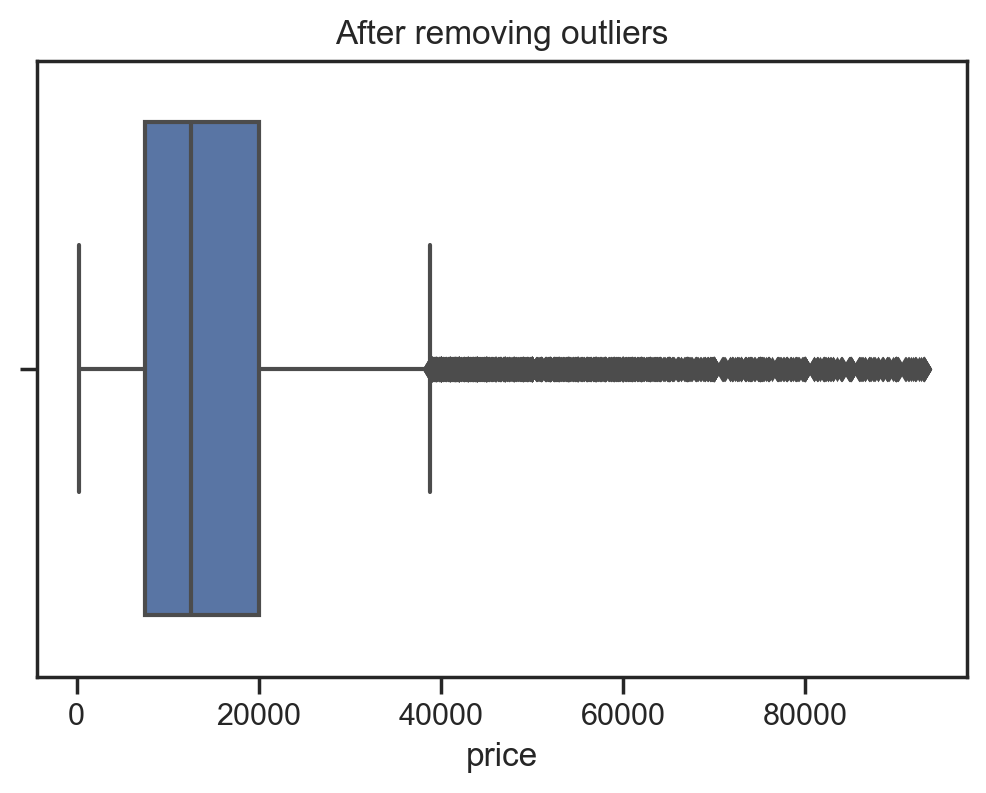

In [44]:
fig, ax = plt.subplots(figsize=(6,4))
plt.title("After removing outliers")
sns.boxplot(data=adv,x='price')
plt.show()

In [45]:
adv['price'].describe()

count   29724.00
mean    15869.26
std     12966.96
min       250.00
25%      7490.00
50%     12577.50
75%     19995.00
max     93073.00
Name: price, dtype: float64

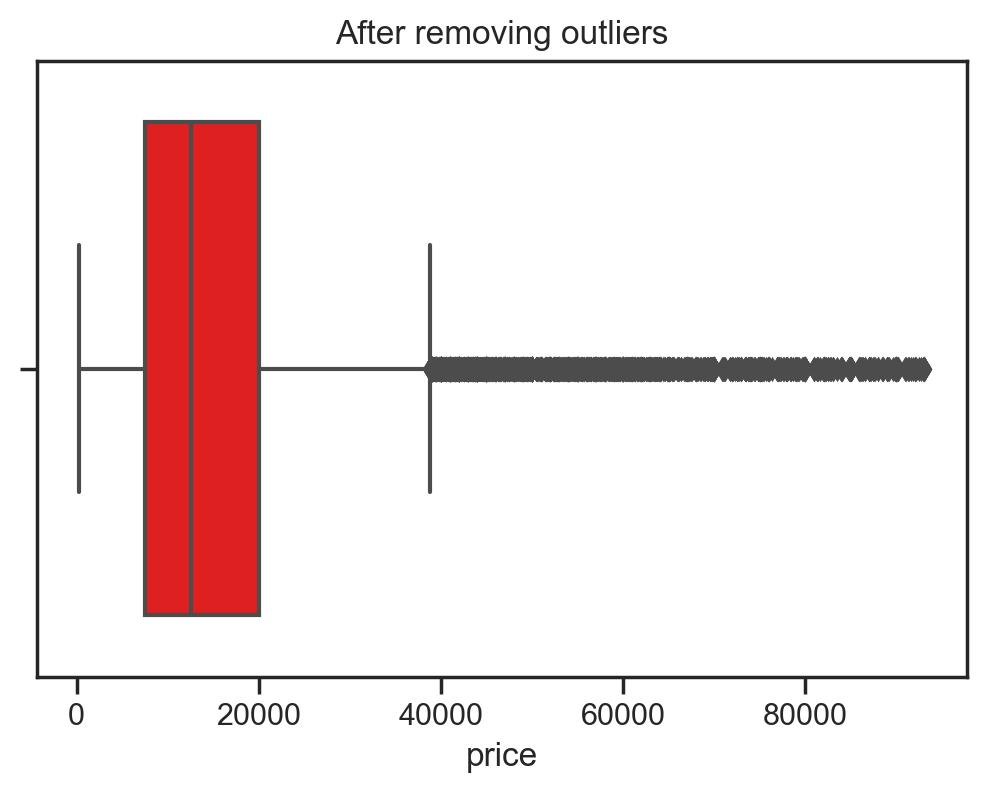

In [46]:
fig, ax = plt.subplots(figsize=(6,4))
plt.title("After removing outliers")
sns.boxplot(data=adv,x='price',color='red')
plt.show()

In [47]:
adv.isnull().sum()

public_reference            0
mileage                     0
reg_code                 2307
standard_colour             0
standard_make               0
standard_model              0
vehicle_condition           0
year_of_registration        0
price                       0
body_type                   0
crossover_car_and_van       0
fuel_type                   0
Price Category              0
dtype: int64

## Noise

<AxesSubplot:ylabel='Frequency'>

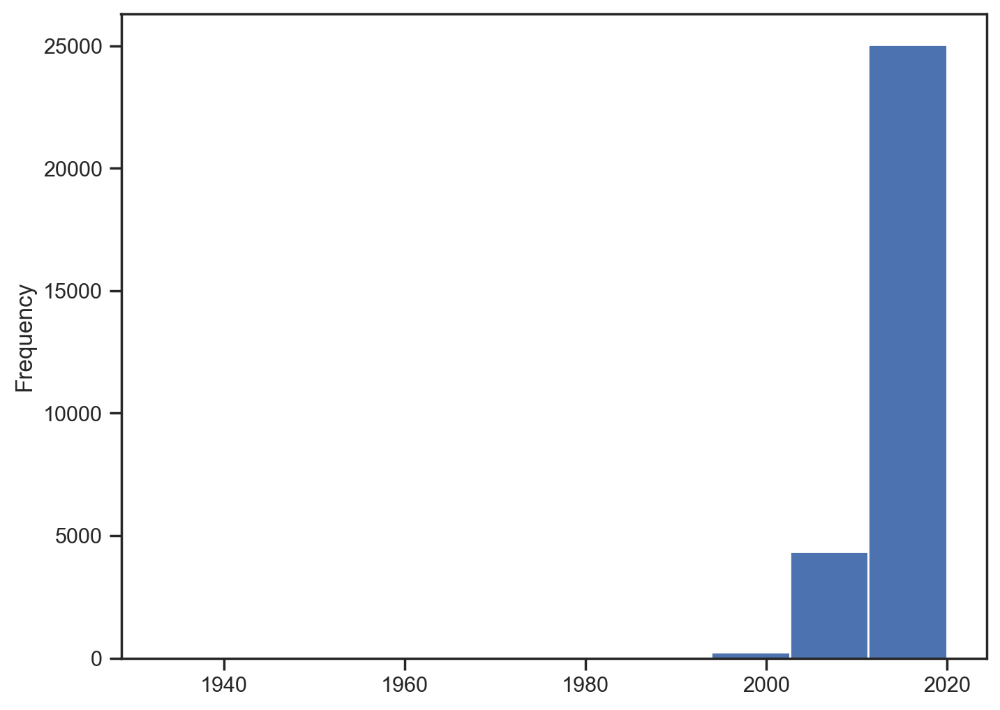

In [48]:
adv['year_of_registration'].plot.hist()

In [49]:
adv['year_of_registration'] = adv['year_of_registration'].astype(int)

In [50]:
adv['current_year']=2020

In [51]:
adv['age_of_car']=adv['current_year']-adv['year_of_registration']

In [52]:
#adv.drop(['year_of_registration','Current_Year'],axis=1, inplace=True)

<AxesSubplot:ylabel='Frequency'>

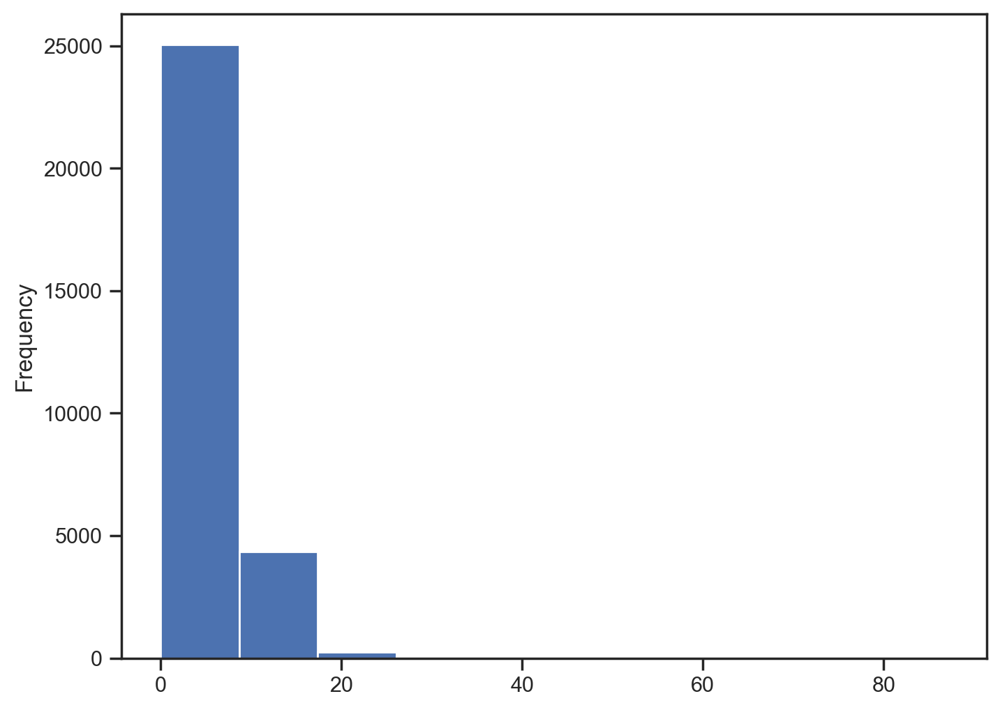

In [53]:
adv['age_of_car'].plot.hist()

In [54]:
# Identify the noisy data
noisy_data = np.where((adv['age_of_car'] > 30) | (adv['age_of_car'] < 0), True, False)

# Create a new DataFrame with the noisy data removed
new_data = adv.loc[~noisy_data]

# Check the shape of the new DataFrame
print(new_data.shape)

# Assign the new DataFrame to the original DataFrame
adv = new_data

(29683, 15)


In [55]:
adv['age_of_car'].describe()

count   29683.00
mean        4.75
std         3.94
min         0.00
25%         2.00
50%         3.00
75%         6.00
max        30.00
Name: age_of_car, dtype: float64

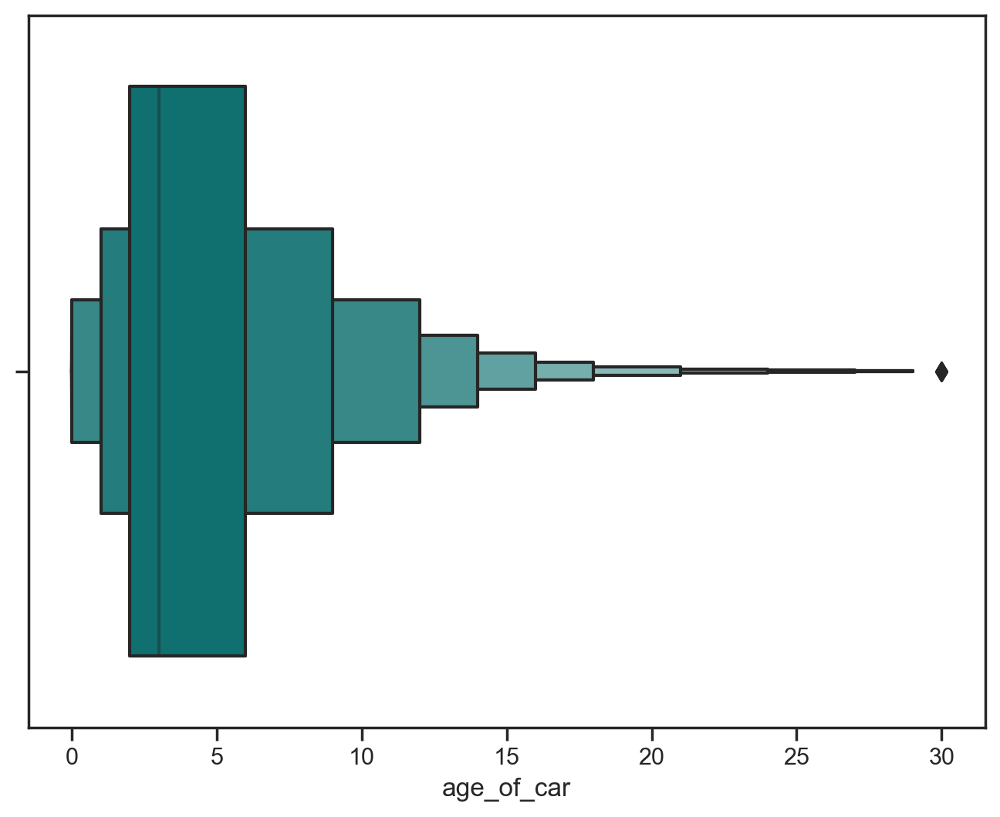

In [56]:
sns.boxenplot(x=adv['age_of_car'],color='teal')
plt.xlabel('age_of_car')
plt.show()



In [57]:
#Encoding

In [58]:
#Categorical encoding for Standard Make

In [59]:
#vehicle['standard_make']=vehicle['standard_make'].astype(str)
#vehicle.groupby(['standard_make'])['price'].mean().sort_values()

In [60]:
#vehicle.groupby(['standard_make'])['price'].mean().sort_values()

In [61]:
#ordinal_labels=vehicle.groupby(['standard_make'])['price'].mean().sort_values().index
#{k:i for i,k in enumerate(ordinal_labels,0)}

In [62]:
# ordinal_labels2={k:i for i,k in enumerate(ordinal_labels,0)}
# vehicle['STD_make']=vehicle['standard_make'].map(ordinal_labels2)
# vehicle.drop(['standard_make'],axis=1, inplace=True)
# vehicle

In [63]:
# #Categorical encoding for vehicle model
# vehicle['standard_model']=vehicle['standard_model'].astype(str)
# vehicle.groupby(['standard_model'])['price'].mean().sort_values()
# ord_labels=vehicle.groupby(['standard_model'])['price'].mean().sort_values().index
# #4
# {k:i for i,k in enumerate(ord_labels,0)}
# #5
# ord_labels1={k:i for i,k in enumerate(ord_labels,0)}
# vehicle['STD_model']=vehicle['standard_model'].map(ord_labels1)
# vehicle.drop(['standard_model'],axis=1, inplace=True)
# vehicle

In [64]:
# #Categorical Encoding for Body Type
# vehicle['body_type']=vehicle['body_type'].astype(str)
# vehicle.groupby(['body_type'])['price'].mean().sort_values()
# ord_labels3=vehicle.groupby(['body_type'])['price'].mean().sort_values().index
# #4
# {k:i for i,k in enumerate(ord_labels3,0)}
# #5
# ord_labels4={k:i for i,k in enumerate(ord_labels3,0)}
# vehicle['body_labels']=vehicle['body_type'].map(ord_labels4)
# vehicle.drop(['body_type'],axis=1, inplace=True)
# vehicle

In [65]:
# #Categorical Encoding for Fuel Type
# vehicle['fuel_type']=vehicle['fuel_type'].astype(str)
# vehicle.groupby(['fuel_type'])['price'].mean().sort_values()
# ord_labels5=vehicle.groupby(['fuel_type'])['price'].mean().sort_values().index
# #4
# {k:i for i,k in enumerate(ord_labels5,0)}
# #5
# ord_labels6={k:i for i,k in enumerate(ord_labels5,0)}
# vehicle['fuel_labels']=vehicle['fuel_type'].map(ord_labels6)
# vehicle.drop(['fuel_type'],axis=1, inplace=True)
# vehicle

In [66]:
# #Categorical Encoding for Standard Colour
# vehicle['standard_colour']=vehicle['standard_colour'].astype(str)
# vehicle.groupby(['standard_colour'])['price'].mean().sort_values()
# ord_labels7=vehicle.groupby(['standard_colour'])['price'].mean().sort_values().index

# {k:i for i,k in enumerate(ord_labels7,0)}

# ord_labels8={k:i for i,k in enumerate(ord_labels7,0)}
# vehicle['STD_colour']=vehicle['standard_colour'].map(ord_labels8)
# vehicle.drop(['standard_colour'],axis=1, inplace=True)
# vehicle

In [67]:
#Dropping these columns as they dont influence price feature.
# vehicle.drop(['public_reference'],axis=1, inplace=True)
# vehicle.drop(['reg_code'],axis=1, inplace=True)
# vehicle.drop(['crossover_car_and_van'],axis=1, inplace=True)


In [68]:
#LE=LabelEncoder()

In [69]:
#vehicle['standard_make']=LE.fit_transform(vehicle['standard_make'])

In [70]:
#vehicle=pd.get_dummies(vehicle,columns=['vehicle_condition','body_type','fuel_type'],drop_first=True)

In [71]:
#vehicle.head(5)

In [72]:
# Splitting the data

In [73]:
# X = vehicle.drop(columns='price')
# y = vehicle['price']

In [74]:
# from sklearn.model_selection import train_test_split
# X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.2,random_state=0)

# Feature Enginnering

In [75]:
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.compose import ColumnTransformer, make_column_transformer
from sklearn.model_selection import GridSearchCV, ParameterGrid
from sklearn.metrics import mean_squared_error
from functools import partial
rmse = partial(mean_squared_error, squared=False)
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.dummy import DummyRegressor
from statsmodels.formula.api import ols
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import PolynomialFeatures
from sklearn.datasets import make_regression


In [76]:
adv.columns

Index(['public_reference', 'mileage', 'reg_code', 'standard_colour',
       'standard_make', 'standard_model', 'vehicle_condition',
       'year_of_registration', 'price', 'body_type', 'crossover_car_and_van',
       'fuel_type', 'Price Category', 'current_year', 'age_of_car'],
      dtype='object')

In [77]:
# drop specified columns inplace
adv.drop(['public_reference', 'reg_code', 'standard_colour', 'standard_model', 'crossover_car_and_van', 'current_year'], axis=1, inplace=True)

### Polynomial

In [78]:
adv.head(3)

,mileage,standard_make,vehicle_condition,year_of_registration,price,body_type,fuel_type,Price Category,age_of_car
0,0.00,Volvo,NEW,2017,73970,SUV,Petrol Plug-in Hybrid,6,3
1,108230.00,Jaguar,USED,2011,7000,Saloon,Diesel,1,9
2,7800.00,SKODA,USED,2017,14000,SUV,Petrol,2,3


### Poly with RandomForestRegressor

In [79]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score
from sklearn.preprocessing import StandardScaler, OneHotEncoder, PolynomialFeatures
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split

df=adv
X = df.drop('price', axis=1)
y = df['price']

# Define the preprocessing pipeline
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), ['age_of_car', 'mileage']),
        ('cat', OneHotEncoder(handle_unknown='ignore'), 
         ['vehicle_condition','Price Category', 'fuel_type', 'body_type', 'standard_make']),
        ('interaction', PolynomialFeatures(degree=2, include_bias=False, interaction_only=True), 
         ['age_of_car', 'mileage'])
    ])

# Define the random forest regression pipeline
rf_pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', RandomForestRegressor(n_estimators=100, random_state=42))
])

# Split data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Fit the pipeline to the training data
rf_pipeline.fit(X_train, y_train)

# Make predictions on the test data
y_pred = rf_pipeline.predict(X_test)

# Calculate the R-squared score
r2 = r2_score(y_test, y_pred)
print('R-squared score:', r2)


R-squared score: 0.9540022672521352



Polynomial basis functions are a way to transform input features into higher-order polynomials that capture non-linear relationships with the target variable. In this case, we applied polynomial basis functions in combination with a random forest model to create a highly accurate predictive model for car prices. The preprocessed features included standardized numerical features and one-hot encoded categorical features, as well as polynomial interactions between certain features. The random forest model was used to learn the relationships between the features and the target variable. The resulting model achieved an impressive R-squared score of 0.95 on the test set, which means that it can explain 95% of the variance in the target variable using the selected features. 

### Visualisation

#### 3D Plot

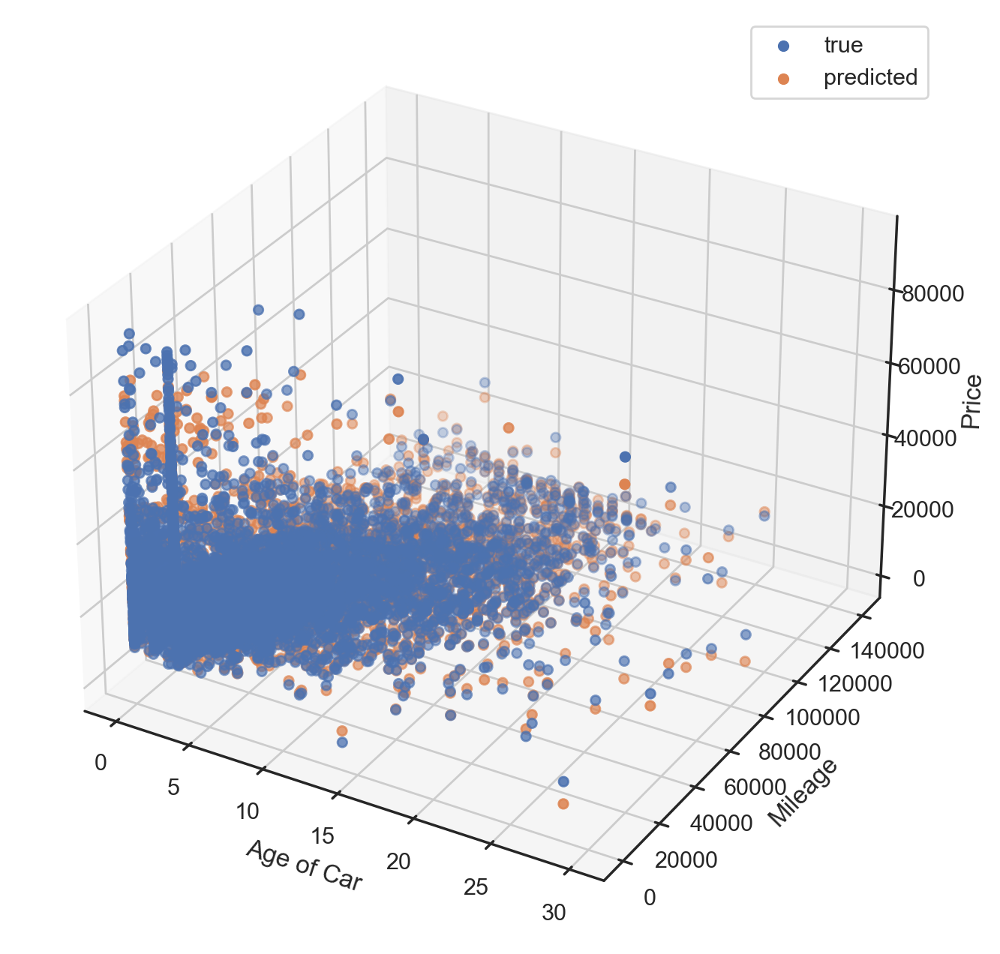

In [80]:
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d

# Create a 3D scatter plot of the interaction between 'age_of_car' and 'mileage'
fig = plt.figure(figsize=(10,8))
ax = fig.add_subplot(111, projection='3d')

# Extract the values of the relevant features and target variable for the test data
age_of_car = X_test['age_of_car'].values
mileage = X_test['mileage'].values
price = y_test.values

# Plot the true prices as a scatter plot
ax.scatter(age_of_car, mileage, price, label='true', cmap='magma')

# Plot the predicted prices as a scatter plot
ax.scatter(age_of_car, mileage, y_pred, label='predicted', cmap='coolwarm')

# Set the labels for the axes and the legend
ax.set_xlabel('Age of Car')
ax.set_ylabel('Mileage')
ax.set_zlabel('Price')
plt.legend()

# Show the plot
plt.show()

# Pair Plot

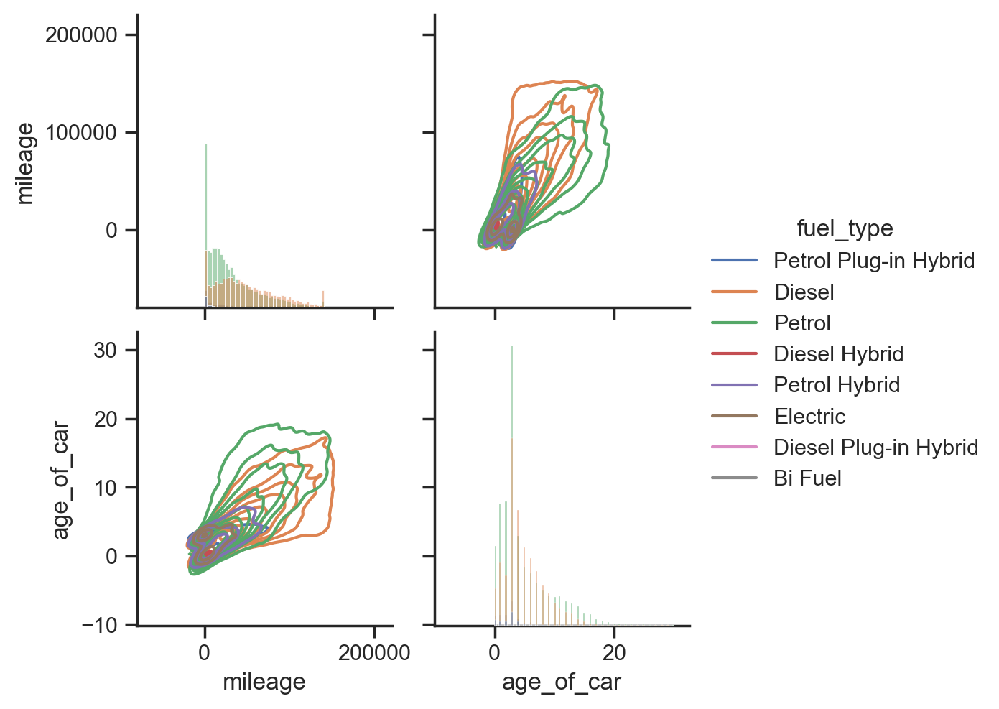

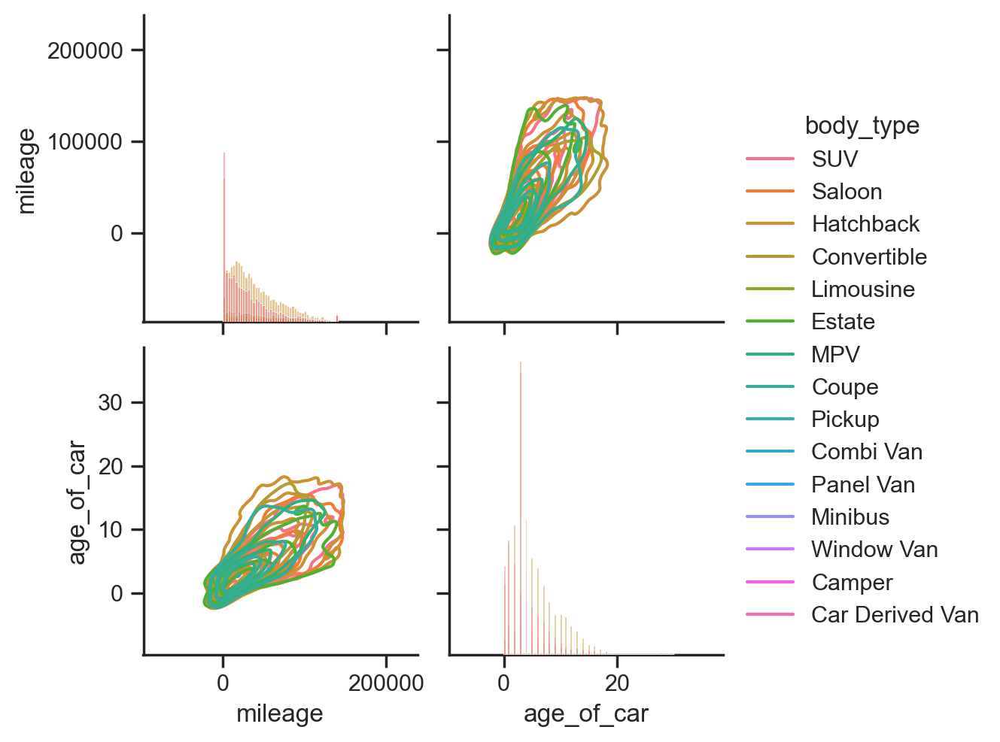

In [81]:
# set style
sns.set(style="ticks", color_codes=True)

# Create a new DataFrame with only the columns you want to plot
selected_data = adv[['mileage', 'age_of_car', 'fuel_type', 'body_type']]

# Create a pairplot with histograms on the diagonal and kernel density estimates off the diagonal
g = sns.pairplot(selected_data, hue="fuel_type", diag_kind="hist", kind="kde")

# You can also create a pairplot with histograms on the diagonal and kernel density estimates off the diagonal
# with the hue based on body_category
g2 = sns.pairplot(selected_data, hue="body_type", diag_kind="hist", kind="kde")

plt.show()

Scatter Plot

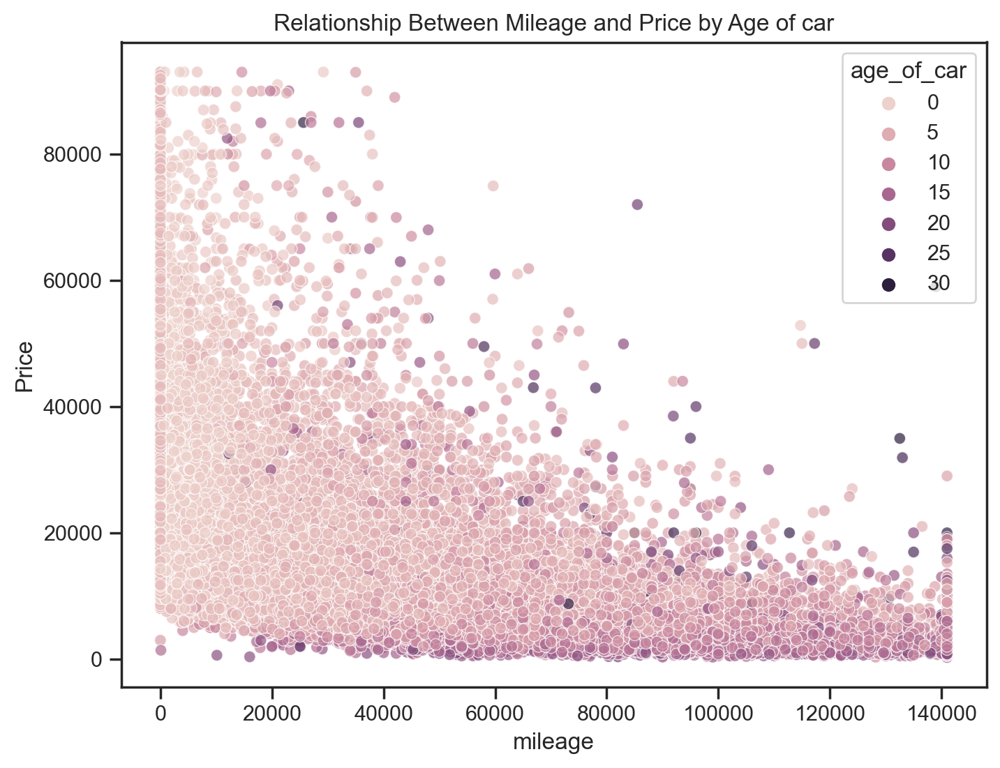

In [82]:
import seaborn as sns
# create a scatter plot with seaborn
sns.scatterplot(data=adv, x='mileage', y='price', hue='age_of_car', alpha=0.7)

# add labels and title
plt.xlabel('mileage')
plt.ylabel('Price')
plt.title('Relationship Between Mileage and Price by Age of car')

# display the plot
plt.show()

Boxen Plot

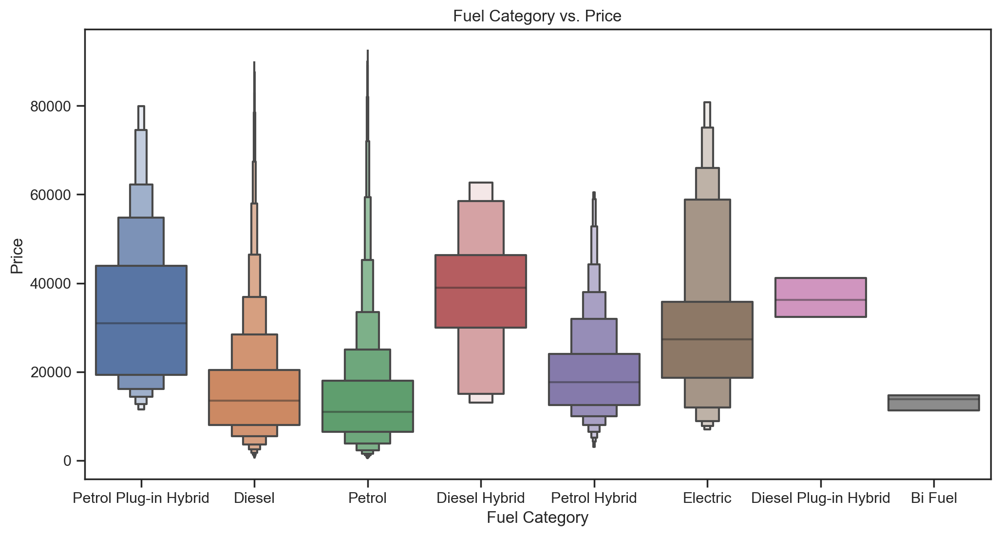

In [83]:
# create boxen plot
fig, ax = plt.subplots(figsize=(12, 6))
sns.boxenplot(data=adv, x='fuel_type', y='price', showfliers=False)

# add labels and title
plt.xlabel('Fuel Category')
plt.ylabel('Price')
plt.title('Fuel Category vs. Price')

# display the plot
plt.show()

Count Plot

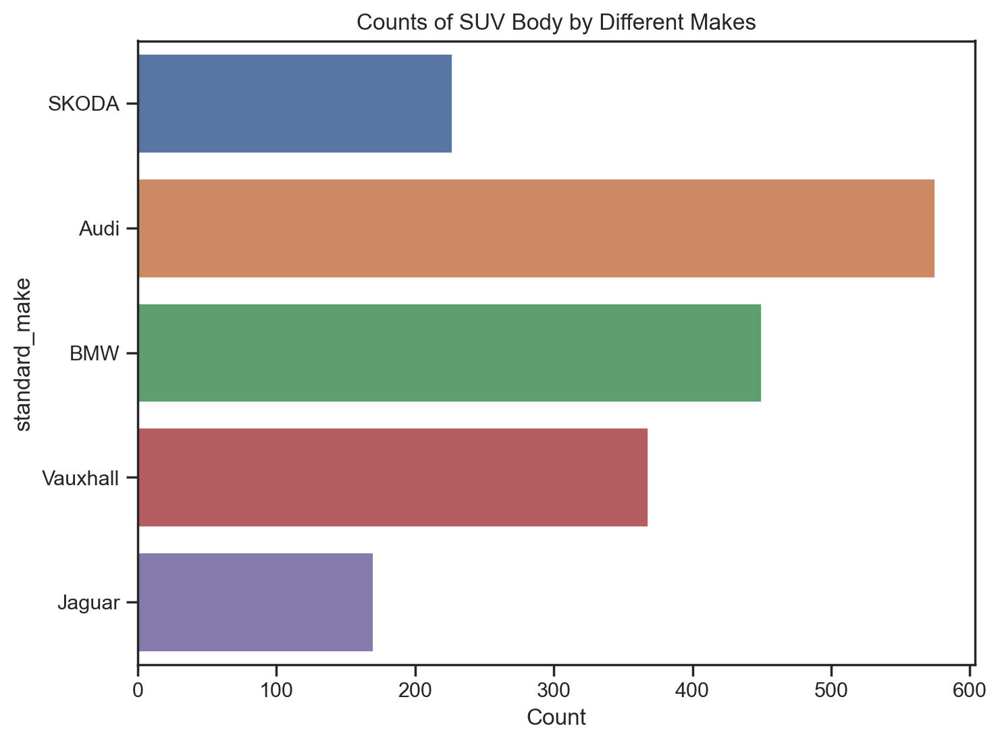

In [84]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# filter data by make and body type
make_filter = ['BMW', 'Audi', 'Vauxhall','Jaguar','SKODA']
body_filter = ['SUV']
filtered_adv = adv.loc[(adv['standard_make'].isin(make_filter)) & (adv['body_type'].isin(body_filter))]

# create count plot
sns.countplot(data=filtered_adv, y='standard_make')

# add labels and title
plt.ylabel('standard_make')
plt.xlabel('Count')
plt.title('Counts of SUV Body by Different Makes')

# display the plot
plt.show()

Scatter Plot

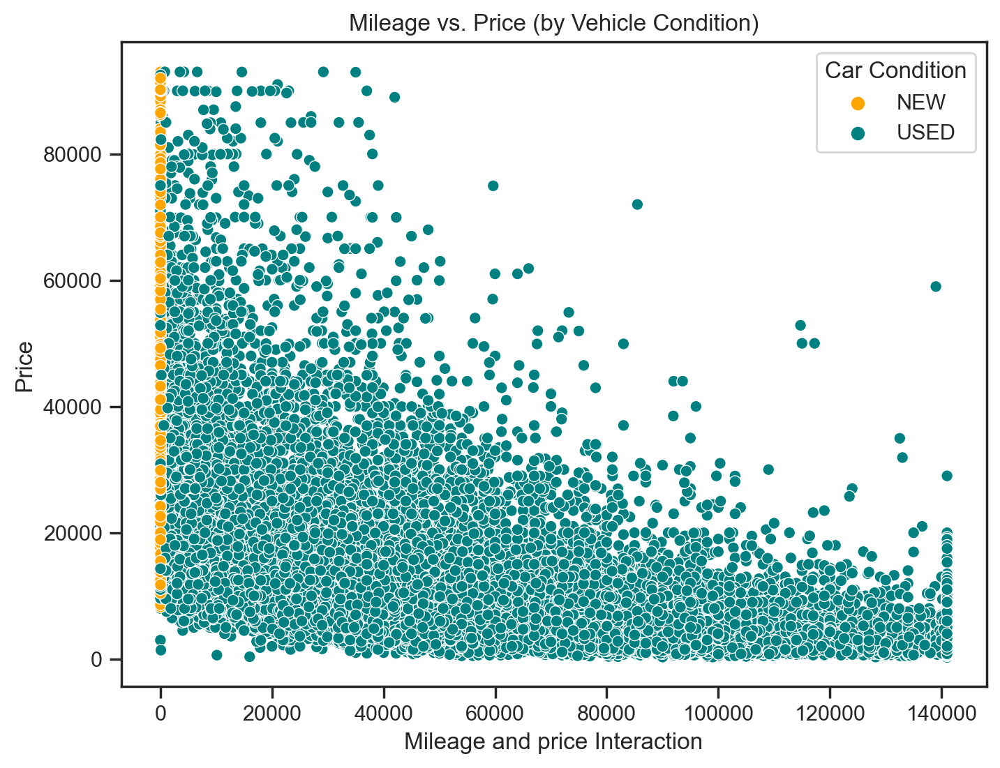

In [85]:
custom_palette = {'NEW': 'orange', 'USED': 'teal'}
sns.scatterplot(data=adv, x='mileage', y='price', hue='vehicle_condition', palette=custom_palette)
plt.xlabel('Mileage and price Interaction')
plt.ylabel('Price')
plt.title('Mileage vs. Price (by Vehicle Condition)')
plt.legend(title='Car Condition')
plt.show()

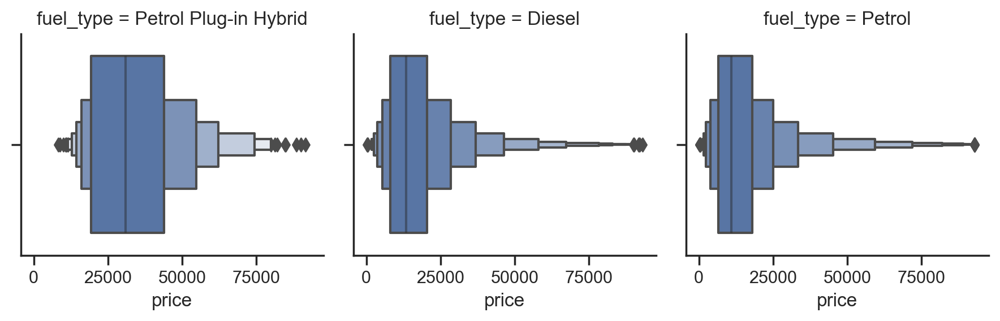

In [86]:
# filter data by fuel type
fuel_filter = ['Petrol Plug-in Hybrid', 'Diesel', 'Petrol']
filtered_adv = adv.loc[adv['fuel_type'].isin(fuel_filter)]

# create FacetGrid with boxen plots for "price" variable
g = sns.FacetGrid(filtered_adv, col="fuel_type")
g.map(sns.boxenplot, "price")

# display the plot
plt.show()

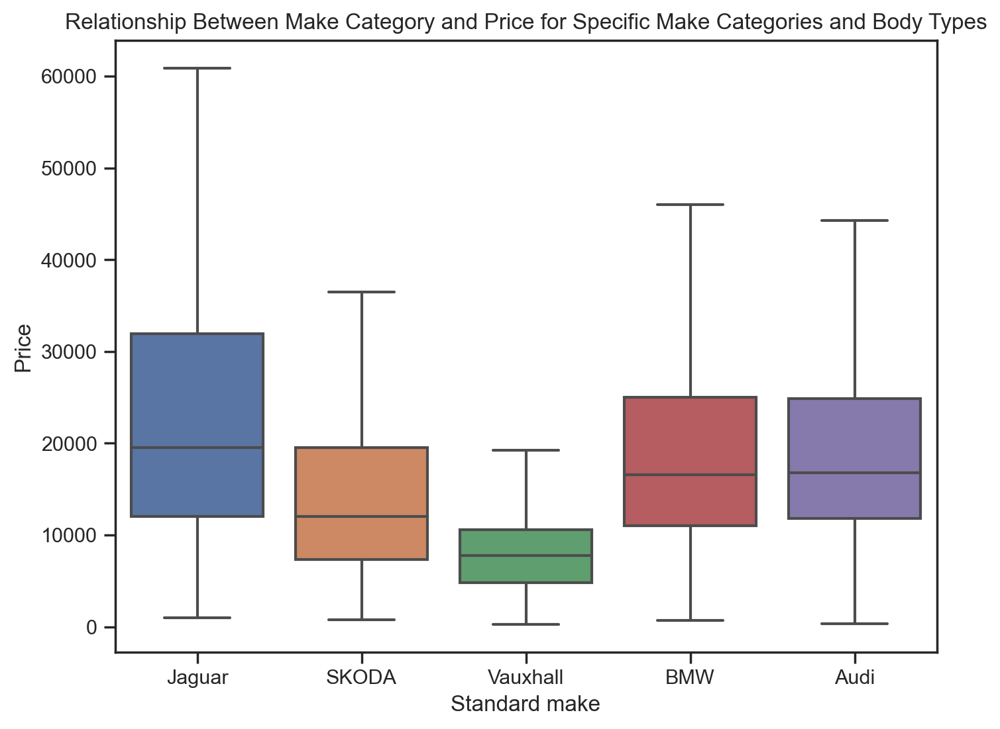

In [87]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# filter data by make and body type
make_filter= ['BMW', 'Audi', 'Vauxhall', 'Jaguar', 'SKODA']
body_filter = ['SUV', 'Hatchback', 'Saloon']
filtered_adv = adv.loc[(adv['standard_make'].isin(make_filter)) & (adv['body_type'].isin(body_filter))]
# create box plot
sns.boxplot(data=filtered_adv, x='standard_make', y='price', showfliers=False)
# add labels and title
plt.xlabel('Standard make')
plt.ylabel('Price')
plt.title('Relationship Between Make Category and Price for Specific Make Categories and Body Types')
plt.show()

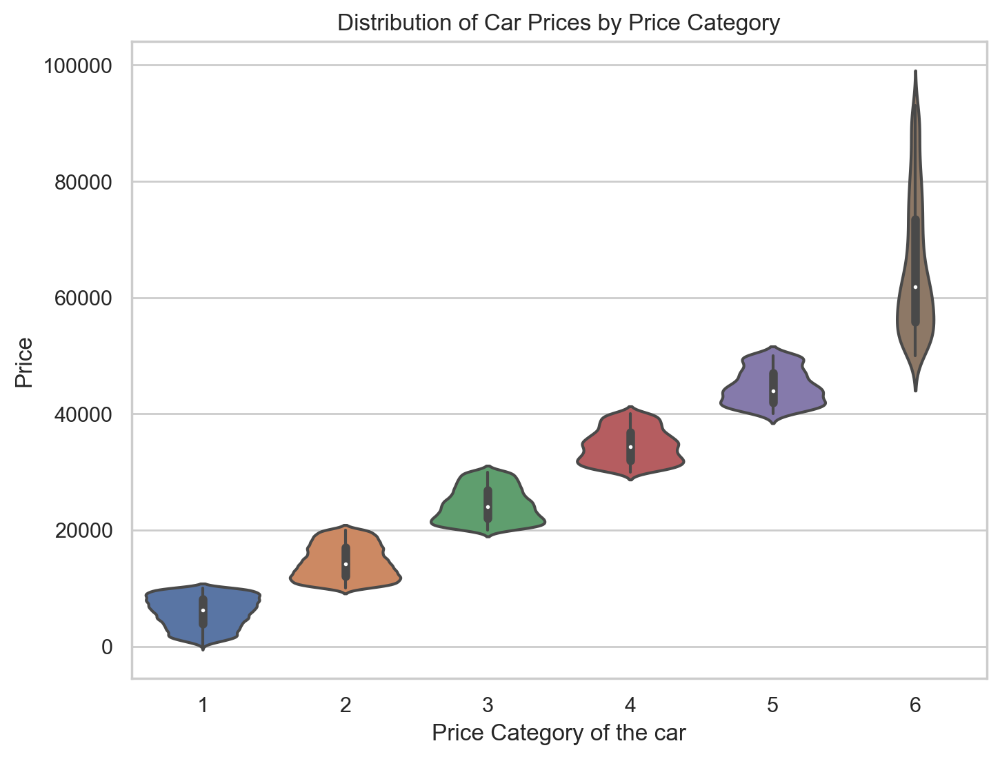

In [88]:
sns.set_style("whitegrid")
# Create violin plot
sns.violinplot(x="Price Category", y="price", data=adv)
# Set title and axis labels
plt.title("Distribution of Car Prices by Price Category")
plt.xlabel("Price Category of the car")
plt.ylabel("Price")
# Show plot
plt.show()

## Encoding and Scaling

In [89]:
adv.head(2)

,mileage,standard_make,vehicle_condition,year_of_registration,price,body_type,fuel_type,Price Category,age_of_car
0,0.00,Volvo,NEW,2017,73970,SUV,Petrol Plug-in Hybrid,6,3
1,108230.00,Jaguar,USED,2011,7000,Saloon,Diesel,1,9


In [90]:
adv['standard_make'].value_counts().nlargest(30)

BMW               2828
Audi              2648
Volkswagen        2545
Vauxhall          2525
Mercedes-Benz     2419
Nissan            1444
Toyota            1345
Peugeot           1144
Land Rover        1051
SKODA              973
Kia                945
Renault            929
Volvo              858
MINI               842
Hyundai            820
Citroen            779
SEAT               703
Fiat               687
Honda              666
Jaguar             544
Mazda              543
Suzuki             355
Porsche            265
Mitsubishi         245
Dacia              238
Lexus              218
Jeep               156
Alfa Romeo         125
DS AUTOMOBILES     103
MG                 101
Name: standard_make, dtype: int64

In [91]:
top_30 = adv['standard_make'].value_counts().nlargest(30).index
adv = adv[adv['standard_make'].isin(top_30)]

In [92]:
adv['standard_make'].nunique()

30

In [93]:
## using one-hot encoding
adv=pd.get_dummies(adv,columns=['standard_make','vehicle_condition','body_type','fuel_type'],drop_first=True)

In [94]:
adv.head(2)

,mileage,year_of_registration,price,Price Category,age_of_car,standard_make_Audi,standard_make_BMW,standard_make_Citroen,standard_make_DS AUTOMOBILES,standard_make_Dacia,...,body_type_SUV,body_type_Saloon,body_type_Window Van,fuel_type_Diesel,fuel_type_Diesel Hybrid,fuel_type_Diesel Plug-in Hybrid,fuel_type_Electric,fuel_type_Petrol,fuel_type_Petrol Hybrid,fuel_type_Petrol Plug-in Hybrid
0,0.00,2017,73970,6,3,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,1
1,108230.00,2011,7000,1,9,0,0,0,0,0,...,0,1,0,1,0,0,0,0,0,0


In [95]:
adv.shape

(29044, 56)

In [96]:
## splitting
X=adv.drop(columns='price')
y=adv['price']

In [97]:
X.head(3)

,mileage,year_of_registration,Price Category,age_of_car,standard_make_Audi,standard_make_BMW,standard_make_Citroen,standard_make_DS AUTOMOBILES,standard_make_Dacia,standard_make_Fiat,...,body_type_SUV,body_type_Saloon,body_type_Window Van,fuel_type_Diesel,fuel_type_Diesel Hybrid,fuel_type_Diesel Plug-in Hybrid,fuel_type_Electric,fuel_type_Petrol,fuel_type_Petrol Hybrid,fuel_type_Petrol Plug-in Hybrid
0,0.00,2017,6,3,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,1
1,108230.00,2011,1,9,0,0,0,0,0,0,...,0,1,0,1,0,0,0,0,0,0
2,7800.00,2017,2,3,0,0,0,0,0,0,...,1,0,0,0,0,0,0,1,0,0


In [98]:
y.head(3)

0    73970
1     7000
2    14000
Name: price, dtype: int64

In [99]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.2,random_state=0)

In [100]:
print("X_train",X_train.shape)
print("X_test",X_test.shape)
print("y_train",y_train.shape)
print("y_test",X_test.shape)

X_train (23235, 55)
X_test (5809, 55)
y_train (23235,)
y_test (5809, 55)


In [101]:
from sklearn.model_selection import train_test_split

from sklearn.preprocessing import StandardScaler

from sklearn.preprocessing import StandardScaler, OrdinalEncoder
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import accuracy_score, mean_absolute_error, mean_squared_error, r2_score

In [102]:
## Scaling

scl=StandardScaler()

X_train = scl.fit_transform(X_train)
X_test = scl.fit_transform(X_test)

In [103]:
X_train

array([[ 1.12805025, -0.08682781, -0.89027788, ..., -1.06701367,
        -0.19223095, -0.12720824],
       [-0.49953418,  0.43366864, -0.03284341, ..., -1.06701367,
        -0.19223095, -0.12720824],
       [-0.01803055, -0.08682781, -0.03284341, ..., -1.06701367,
        -0.19223095, -0.12720824],
       ...,
       [ 0.2055544 ,  0.17342041, -0.89027788, ...,  0.93719511,
        -0.19223095, -0.12720824],
       [-0.37865337,  0.69391686,  3.39689444, ...,  0.93719511,
        -0.19223095, -0.12720824],
       [ 0.44612802,  0.17342041, -0.03284341, ..., -1.06701367,
        -0.19223095, -0.12720824]])

### Feature Selection by SelectKBest

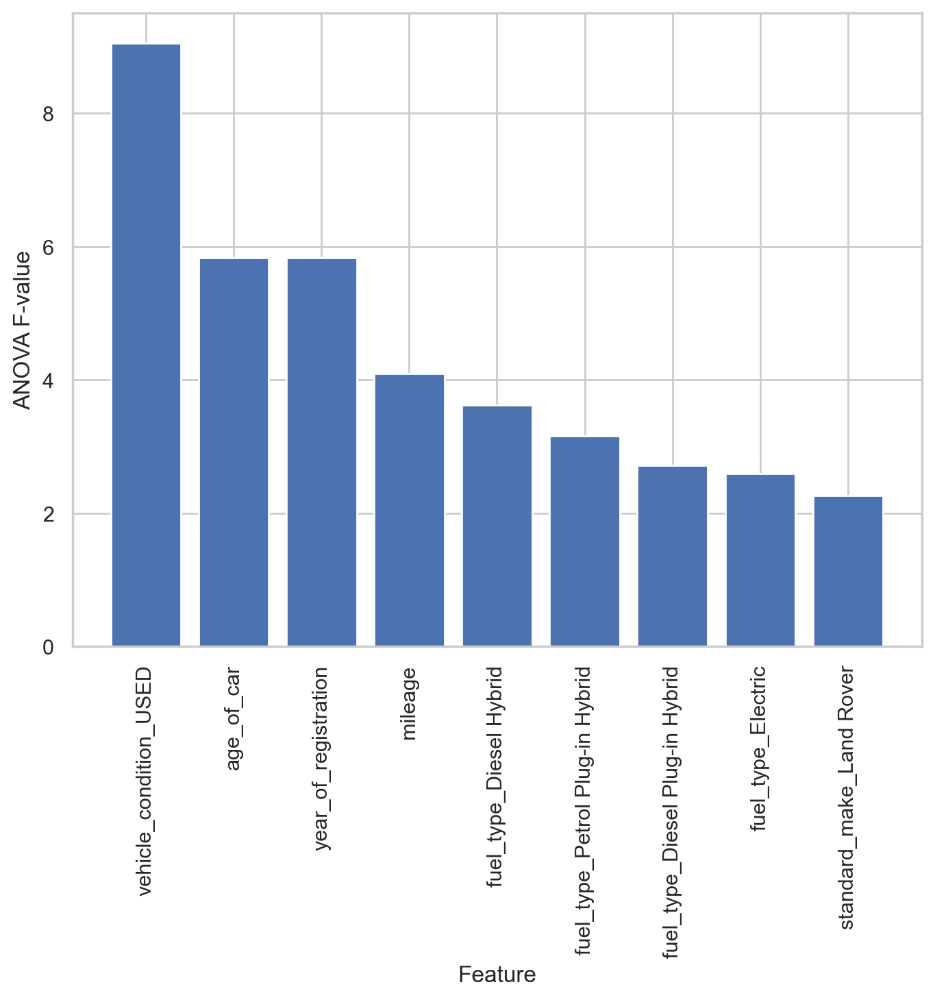

In [104]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.feature_selection import SelectKBest, f_classif

df = adv

# Separate the features from the target variable
X = df.drop(columns='price')
y = df['price']

# Perform feature selection using ANOVA F-value
selector = SelectKBest(f_classif, k=10)
selector.fit(X, y)

# Get the column names and scores of all the features
scores = pd.DataFrame({'feature': X.columns, 'score': selector.scores_})

# Sort the features by score in descending order
scores_sorted = scores.sort_values('score', ascending=False)

# Get the top 10 features
top_10_features = scores_sorted.head(10)

# Plot the top 10 features based on their ANOVA F-value
plt.bar(top_10_features['feature'], top_10_features['score'])
plt.xticks(rotation=90)
plt.xlabel('Feature')
plt.ylabel('ANOVA F-value')
plt.show()

### Dimentionality : PCA

In [105]:

import pandas as pd
from sklearn.decomposition import PCA

df=adv

# Separate the features from the target variable
X = df.drop(columns='price')
y = df['price']

# Perform PCA
pca = PCA(n_components=10)
X_pca = pca.fit_transform(X)

# Create a new DataFrame with the principal components
pc_names = ['PC'+str(i+1) for i in range(10)]
X_pca_df = pd.DataFrame(X_pca, columns=pc_names)

# Print the explained variance ratio of each principal component
print(pca.explained_variance_ratio_)

[9.99999985e-01 1.17108136e-08 1.00061662e-09 3.45516678e-10
 2.22867829e-10 1.36975641e-10 8.22461854e-11 7.72770700e-11
 7.56234895e-11 7.19694908e-11]


PCA can help identify the most important factors that contribute to the price of a car. However, when using PCA for dimensionality reduction, it's important to balance the trade-off between reducing the number of features and retaining enough information to accurately represent the original dataset. Other dimensionality reduction techniques may be more appropriate if the explained variance ratio is highly skewed towards a small number of components. In this case, it looks like the first principal component explains almost all of the variance in the dataset (99%), while the remaining components explain very little variance.

## Model Building

### Linear

In [106]:
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

df=adv
# Separate the features from the target variable
X = df.drop(columns='price')
y = df['price']

# Perform PCA
pca = PCA(n_components=10)
X_pca = pca.fit_transform(X)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_pca, y, test_size=0.2, random_state=42)

# Fit a linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Predict on the test set
y_pred = model.predict(X_test)

# Calculate MSE, MAE, and R2
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Print the results
print('Linear Regression Model:')
print('MSE:', mse)
print('MAE:', mae)
print('R-squared:', r2)

Linear Regression Model:
MSE: 13955338.579409733
MAE: 2606.808682750375
R-squared: 0.9139953769852173


### Random Forest

In [107]:
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

df=adv

# Separate the features from the target variable
X = df.drop(columns='price')
y = df['price']

# Perform PCA
pca = PCA(n_components=10)
X_pca = pca.fit_transform(X)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_pca, y, test_size=0.2, random_state=42)

# Fit a random forest regressor model
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Predict on the test set
y_pred = model.predict(X_test)

# Calculate MSE, MAE, and R2
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Print the results
print('MSE:', mse)
print('MAE:', mae)
print('R-squared:', r2)

MSE: 8228225.209584895
MAE: 1778.2999548020957
R-squared: 0.9492907031094754


### Gradient Boost

In [108]:
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

df=adv

# Separate the features from the target variable
X =df.drop(columns='price')
y = df['price']

# Perform PCA
pca = PCA(n_components=10)
X_pca = pca.fit_transform(X)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_pca, y, test_size=0.2, random_state=42)

# Fit a gradient boosting regressor model
model = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, random_state=42)
model.fit(X_train, y_train)

# Predict on the test set
y_pred = model.predict(X_test)

# Calculate MSE, MAE, and R2
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Print the results
print('MSE:', mse)
print('MAE:', mae)
print('R-squared:', r2)

MSE: 8831129.049483156
MAE: 1974.4041374323874
R-squared: 0.9455750987069337


### Ranking

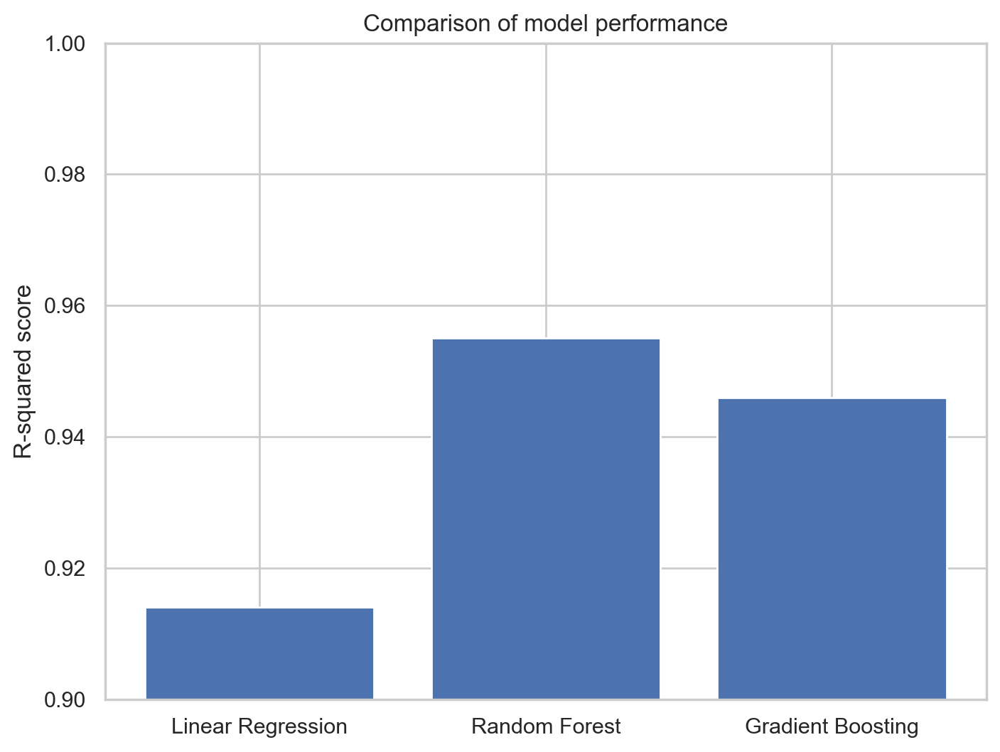

In [109]:

# Define the R-squared scores for each model
linear_r2 = 0.914
rf_r2 = 0.955
gb_r2 = 0.946

# Create a list of the R-squared scores and the model names
r2_scores = [linear_r2, rf_r2, gb_r2]
model_names = ['Linear Regression', 'Random Forest', 'Gradient Boosting']

# Create a bar plot of the R-squared scores
plt.bar(model_names, r2_scores)
plt.ylim([0.9, 1.0])
plt.ylabel('R-squared score')
plt.title('Comparison of model performance')
plt.show()

### Ensemble: VotingRegressor

In [110]:
import pandas as pd
from sklearn.ensemble import VotingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

df=adv

# Separate the features from the target variable
X = df.drop(columns='price')
y = df['price']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Fit a linear regression model
lr = LinearRegression()
lr.fit(X_train, y_train)

# Fit a random forest regressor model
rf = RandomForestRegressor(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

# Create a voting regressor that combines the predictions of the linear regression and random forest regressor
voting = VotingRegressor([('lr', lr), ('rf', rf)])
voting.fit(X_train, y_train)

# Predict on the test set
y_pred = voting.predict(X_test)

# Calculate MSE, MAE, and R2
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Print the results
print('MSE:', mse)
print('MAE:', mae)
print('R-squared:', r2)

MSE: 8559933.113845672
MAE: 1906.2214299856066
R-squared: 0.9472464378919289


### Hyperparameter Tuning: Randomized CV Search

In [111]:
import pandas as pd
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

df=adv
# Separate the features from the target variable
X = df.drop(columns='price')
y = df['price']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define the parameter grid for the random forest regressor
param_dist = {
    'n_estimators': [50, 100, 150],
    'max_depth': [5, 10, 15],
    'min_samples_split': [2, 4, 6],
    'min_samples_leaf': [1, 2, 3]
}

# Create a random forest regressor object
rf = RandomForestRegressor(random_state=42)

# Use randomized search CV to find the best hyperparameters for the random forest regressor
rand_search = RandomizedSearchCV(rf, param_distributions=param_dist, n_iter=10, cv=5, random_state=42, n_jobs=-1)
rand_search.fit(X_train, y_train)

# Predict on the test set using the best estimator found by randomized search CV
y_pred = rand_search.best_estimator_.predict(X_test)

# Calculate MSE, MAE, and R2
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Print the results
print('MSE:', mse)
print('MAE:', mae)
print('R-squared:', r2)

MSE: 7187805.335909034
MAE: 1720.0155192101404
R-squared: 0.9557026520925408


# Trade-off

MSE: 8174828.4891507225
MAE: 1778.2043723035094
R-squared: 0.9496197789527474


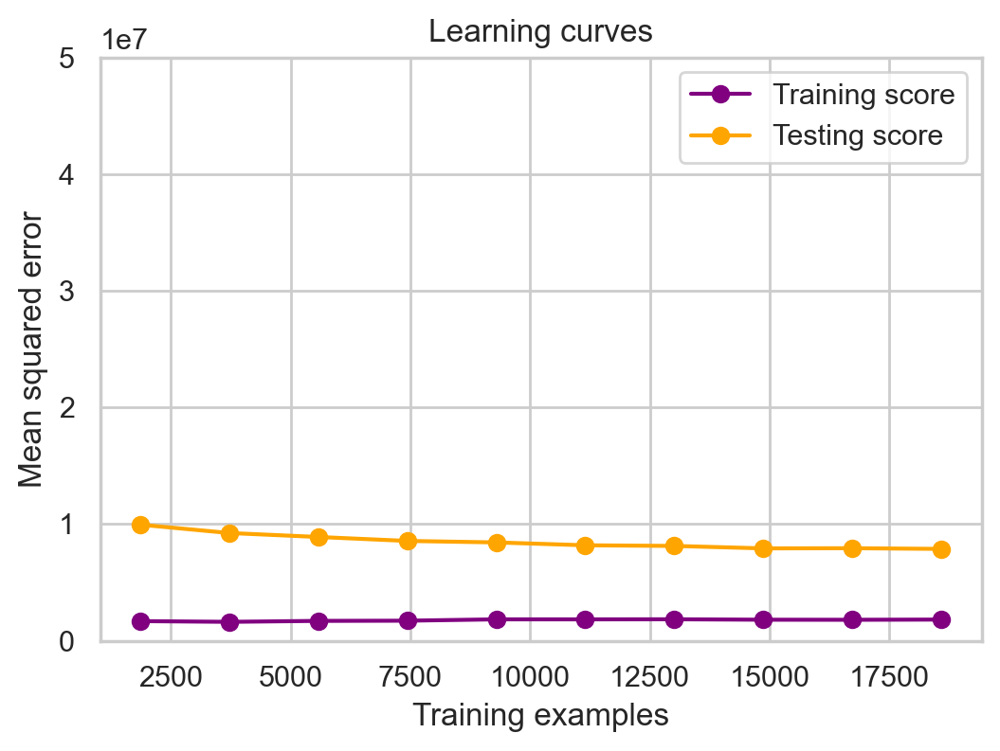

In [112]:
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split, learning_curve
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score


df=adv

# Separate the features from the target variable
X = df.drop(columns='price')
y = df['price']

# Perform PCA
pca = PCA(n_components=10)
X_pca = pca.fit_transform(X)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_pca, y, test_size=0.2, random_state=42)

# Fit a random forest regressor model
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Predict on the test set
y_pred = model.predict(X_test)

# Calculate MSE, MAE, and R2
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Print the results
print('MSE:', mse)
print('MAE:', mae)
print('R-squared:', r2)

# plot learning curves
train_sizes, train_scores, test_scores = learning_curve(
    model, X_train, y_train, train_sizes=np.linspace(0.1, 1.0, 10),
    scoring='neg_mean_squared_error', cv=5, n_jobs=-1)

train_scores_mean = -np.mean(train_scores, axis=1)
test_scores_mean = -np.mean(test_scores, axis=1)

plt.figure(figsize=(6,4))
plt.plot(train_sizes, train_scores_mean, 'o-', color='purple', label='Training score')
plt.plot(train_sizes, test_scores_mean, 'o-', color='orange', label='Testing score')
plt.title('Learning curves')
plt.xlabel('Training examples')
plt.ylabel('Mean squared error')
plt.legend(loc='best')
plt.ylim(0, 50000000)
plt.show()

# Model Evaluation and Analysis

### Cross-Validation

In [113]:
import pandas as pd
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split, RandomizedSearchCV, cross_val_score
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

df=adv

# Separate the features from the target variable
X = df.drop(columns='price')
y = df['price']

# Define the parameter grid for the random forest regressor
param_dist = {
    'n_estimators': [50, 100, 150],
    'max_depth': [5, 10, 15],
    'min_samples_split': [2, 4, 6],
    'min_samples_leaf': [1, 2, 3]
}

# Create a random forest regressor object
rf = RandomForestRegressor(random_state=42)

# Use randomized search CV with cross-validation to find the best hyperparameters for the random forest regressor
rand_search = RandomizedSearchCV(rf, param_distributions=param_dist, n_iter=10, cv=5, random_state=42, n_jobs=-1)
scores = cross_val_score(rand_search, X, y, cv=5, scoring='r2')
print('Cross-validation scores:', scores)
print('Mean R-squared:', scores.mean())

# Fit the best estimator found by randomized search CV on the entire dataset
rand_search.fit(X, y)
best_rf = rand_search.best_estimator_

# Predict on the test set using the best estimator found by randomized search CV
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
y_pred = best_rf.predict(X_test)

# Calculate MSE, MAE, and R2
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Print the results
print('MSE:', mse)
print('MAE:', mae)
print('R-squared:', r2)

Cross-validation scores: [0.95762276 0.95908772 0.9569289  0.95595627 0.95589362]
Mean R-squared: 0.9570978536549368
MSE: 4406791.384409189
MAE: 1392.4767448829627
R-squared: 0.9728416168791416


### True vs Predicted price

R-squared: 0.9536390645336745


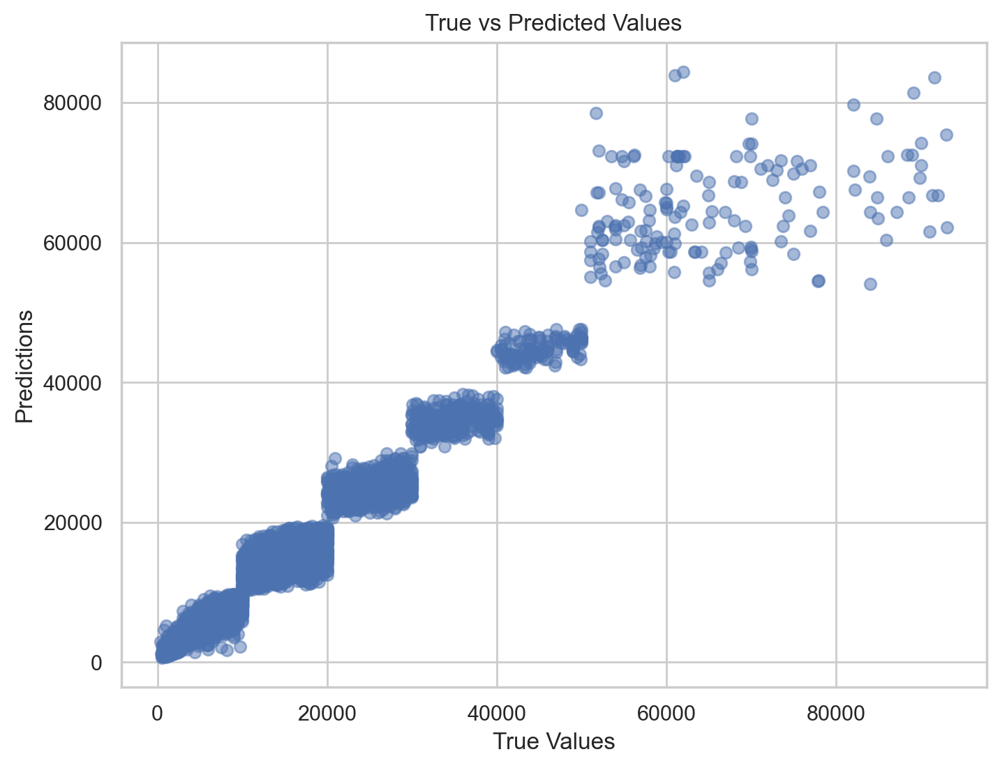

In [114]:
df=adv

# Separate the features from the target variable
X = df.drop(columns='price')
y = df['price']

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create a random forest regressor object
rf = RandomForestRegressor(random_state=42)

# Fit the random forest regresso r on the training set
rf.fit(X_train, y_train)

# Make predictions on the test set
y_pred = rf.predict(X_test)

# Calculate the R2 score
r2 = r2_score(y_test, y_pred)
print('R-squared:', r2)

# Create a true vs predicted plot
plt.scatter(y_test, y_pred, alpha=0.5 )
plt.xlabel('True Values')
plt.ylabel('Predictions')
plt.title('True vs Predicted Values')
plt.show()

### SHAP

### Global explanation by Summary plot

In [115]:
pip install shap

Note: you may need to restart the kernel to use updated packages.


 98%|===================| 98/100 [00:17<00:00]        

Elapsed time: 16.6577467918396


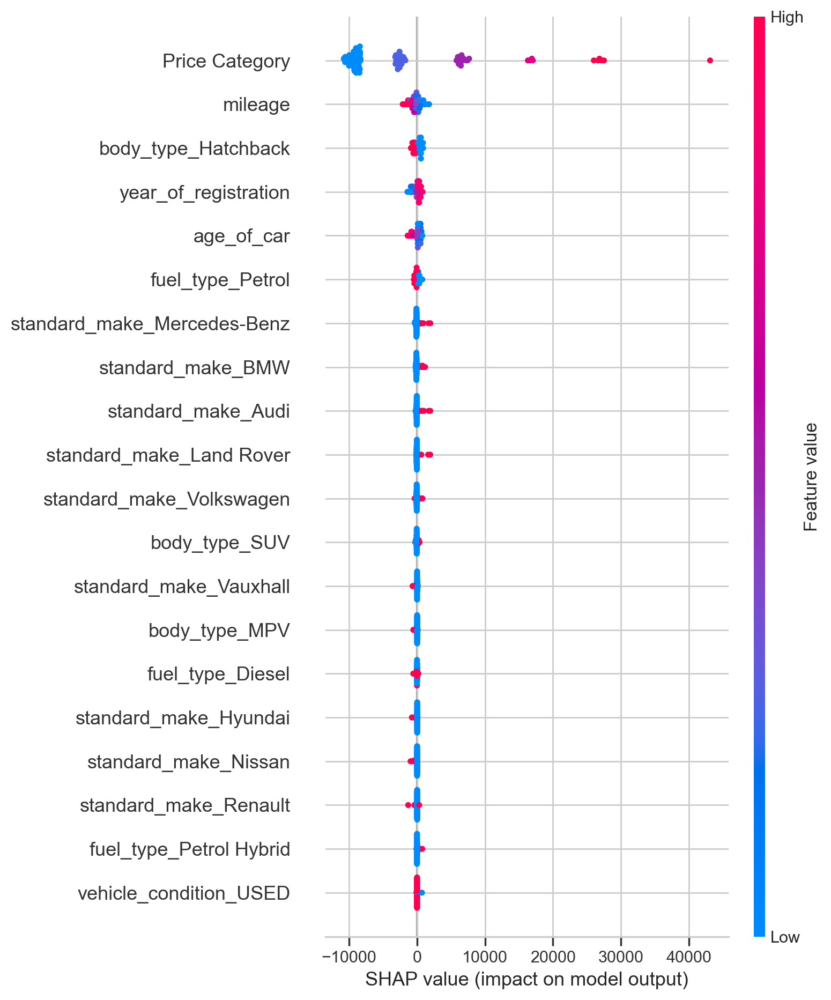

In [116]:
import pandas as pd
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split

import shap
import time

df=adv
# Separate the features from the target variable
X = df.drop(columns='price')
y = df['price']

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create a random forest regressor object
rf = RandomForestRegressor(random_state=42)

# Fit the random forest regressor on the training set
rf.fit(X_train, y_train)

# Create a SHAP explainer object
explainer = shap.Explainer(rf, X_train)

# Record the start time
start_time = time.time()

# Calculate SHAP values for the first 100 rows in the test set
shap_values = explainer(X_test.iloc[:100])

# Print the elapsed time
print('Elapsed time:', time.time() - start_time)

# Create a SHAP summary plot
shap.summary_plot(shap_values, X_test.iloc[:100])

### SHAP Local Explanaton by Force plot

In [117]:
import pandas as pd
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
import shap

df=adv

# Separate the features from the target variable
X = df.drop(columns='price')
y = df['price']

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create a random forest regressor object
rf = RandomForestRegressor(random_state=42)

# Fit the random forest regressor on the training set
rf.fit(X_train, y_train)

# Select a random instance from the test set
idx = 42
instance = X_test.iloc[[idx]]

# Create a SHAP explainer object
explainer = shap.Explainer(rf, X_train)

# Calculate SHAP values for the selected instance
shap_values = explainer(instance)

# Create a SHAP force plot
shap.force_plot(explainer.expected_value, shap_values.values[0], instance.iloc[0])

In [118]:
import shap

# run initjs() to load the necessary JavaScript library
shap.initjs()

# create the SHAP force plot
shap.force_plot(explainer.expected_value, shap_values.values[0], instance.iloc[0])

### Partial Dependency Plot: PDP

In [119]:
pip install pdpbox


  Using cached PDPbox-0.2.1-py3-none-any.whl
  Using cached matplotlib-3.1.1.tar.gz (37.8 MB)
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Running setup.py clean for matplotlib
Failed to build matplotlib
  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.5.2
    Uninstalling matplotlib-3.5.2:
      Successfully uninstalled matplotlib-3.5.2
  Running setup.py install for matplotlib: started
  Running setup.py install for matplotlib: finished with status 'error'
  Rolling back uninstall of matplotlib
  Moving to c:\users\janha\anaconda3\lib\site-packages\__pycache__\pylab.cpython-39.pyc
   from C:\Users\janha\AppData\Local\Temp\pip-uninstall-vsqxnmtg\pylab.cpython-39.pyc
  Moving to c:\users\janha\anaconda3\lib\site-packages\matplotlib-3.5.2-py3.9-nspkg.pth
   from C:\Users\janha\AppData\Local\Temp\pip-uninstall-vk_8jzmv\matplotlib-3.5.2-py3.9-nspkg.pth
  Moving to c:\users\janha\anaconda3\lib\site-

  error: subprocess-exited-with-error
  
  python setup.py bdist_wheel did not run successfully.
  exit code: 1
  
  [501 lines of output]
  Edit setup.cfg to change the build options
  
  BUILDING MATPLOTLIB
    matplotlib: yes [3.1.1]
        python: yes [3.9.13 (main, Aug 25 2022, 23:51:50) [MSC v.1916 64 bit
                    (AMD64)]]
      platform: yes [win32]
  
  OPTIONAL SUBPACKAGES
   sample_data: yes [installing]
         tests: no  [skipping due to configuration]
  
  OPTIONAL BACKEND EXTENSIONS
           agg: yes [installing]
         tkagg: yes [installing; run-time loading from Python Tcl/Tk]
        macosx: no  [Mac OS-X only]
  
  OPTIONAL PACKAGE DATA
          dlls: no  [skipping due to configuration]
  
  C:\Users\janha\anaconda3\lib\site-packages\setuptools\dist.py:286: SetuptoolsDeprecationWarning: The namespace_packages parameter is deprecated, consider using implicit namespaces instead (PEP 420).
    warnings.warn(msg, SetuptoolsDeprecationWarning)
  running

In [120]:
adv.head(2)

,mileage,year_of_registration,price,Price Category,age_of_car,standard_make_Audi,standard_make_BMW,standard_make_Citroen,standard_make_DS AUTOMOBILES,standard_make_Dacia,...,body_type_SUV,body_type_Saloon,body_type_Window Van,fuel_type_Diesel,fuel_type_Diesel Hybrid,fuel_type_Diesel Plug-in Hybrid,fuel_type_Electric,fuel_type_Petrol,fuel_type_Petrol Hybrid,fuel_type_Petrol Plug-in Hybrid
0,0.00,2017,73970,6,3,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,1
1,108230.00,2011,7000,1,9,0,0,0,0,0,...,0,1,0,1,0,0,0,0,0,0


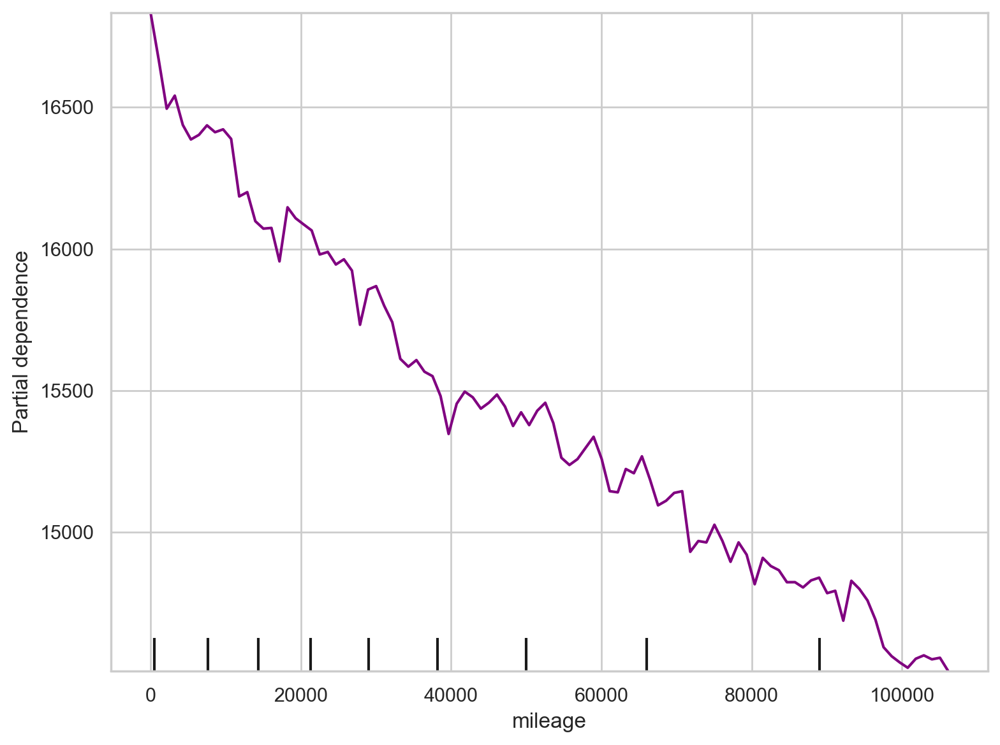

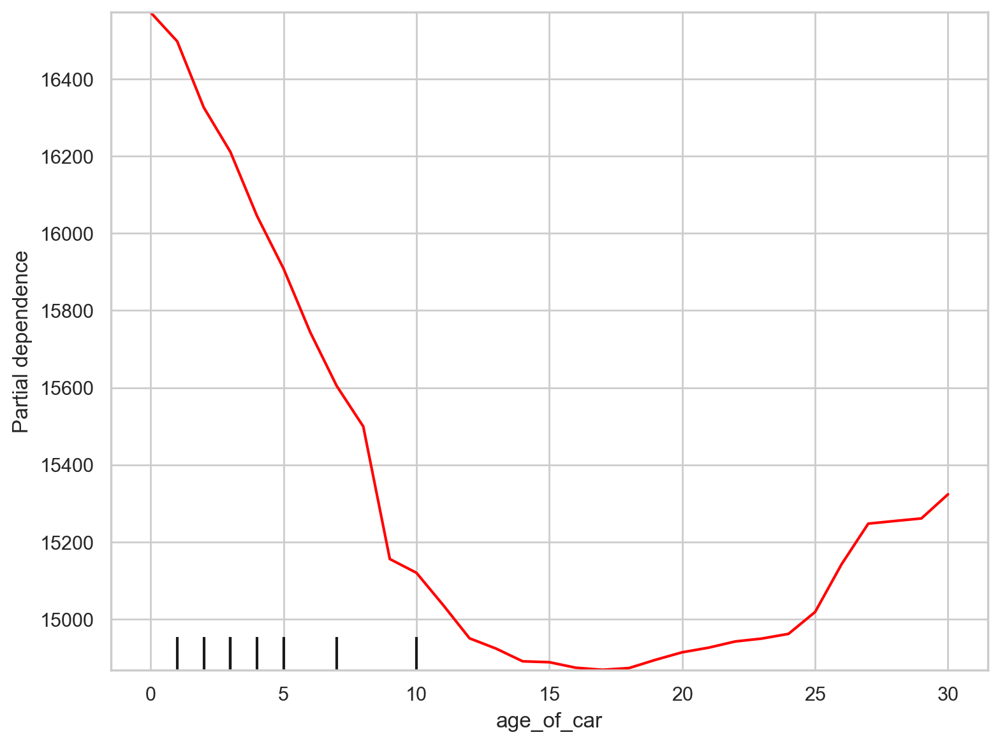

In [121]:
from sklearn.inspection import plot_partial_dependence

# Create and fit a random forest regressor
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X, y)

# Generate partial dependency plots for features age of car and mileage
fig, ax = plt.subplots()
plot_partial_dependence(model, X, [0], ax=ax, line_kw={'color': 'purple'})
fig.tight_layout()

fig2, ax2 = plt.subplots()
plot_partial_dependence(model, X, [3], ax=ax2, line_kw={'color': 'red'})
fig2.tight_layout()